In [2]:
from matplotlib import pyplot as plt
import cv2 as cv
import numpy as np
import os
import data_science_functions as ds
import project_tools as pt
from glob import glob as glob
from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.pipeline import make_pipeline

import pandas as pd

**Table of contents**<a id='toc0_'></a>    
- 1. [Images caracteristics](#toc1_)    
- 2. [Discovering ORB](#toc2_)    
- 3. [ ORB descriptors on all the images in the dataset.](#toc3_)    
  - 3.1. [Generation](#toc3_1_)    
  - 3.2. [Exploration](#toc3_2_)    
    - 3.2.1. [images with no keypoints](#toc3_2_1_)    
  - 3.3. [Create image vectors](#toc3_3_)    
    - 3.3.1. [Finding visual words](#toc3_3_1_)    
  - 3.4. [Build the image vector for the first image](#toc3_4_)    
  - 3.5. [Image vectors on the full dataset.](#toc3_5_)    
- 4. [Exploring pre-processing and parameters influences on the ORB keypoints detection.](#toc4_)    
  - 4.1. [ORB parameters on a resized image](#toc4_1_)    
- 5. [Generate ORB descriptors with histogram equalization and median filtering](#toc5_)    
  - 5.1. [Exploration](#toc5_1_)    
  - 5.2. [Create image vectors](#toc5_2_)    
    - 5.2.1. [Finding visual words](#toc5_2_1_)    
  - 5.3. [Build the image vector for the first image](#toc5_3_)    
  - 5.4. [Image vectors on the full dataset.](#toc5_4_)    
  - 5.5. [Increasing max number of keypoints.](#toc5_5_)    
    - 5.5.1. [tfidf?](#toc5_5_1_)    
    - 5.5.2. [Exploring matches found with the cosine similarity](#toc5_5_2_)    

<!-- vscode-jupyter-toc-config
	numbering=true
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# 1.  [&#9650;](#toc0_) <a id='toc1_'></a>Images caracteristics

In [3]:
metadata = pd.read_csv('./data/Flipkart/Images/metadata.csv.gz')
metadata.head()

,image,shape,n_pixels,mean_gray,min_gray,max_gray,category
0,009099b1f6e1e8f893ec29a7023153c4.jpg,"(1162, 687, 3)",798294,172.415863,0,255,watches
1,0096e89cc25a8b96fb9808716406fe94.jpg,"(904, 1478, 3)",1336112,156.565580,0,255,kitchen_&_dining
2,00cbbc837d340fa163d11e169fbdb952.jpg,"(326, 1347, 3)",439122,192.004357,9,255,home_furnishing
3,00d84a518e0550612fcfcba3b02b6255.jpg,"(857, 1100, 3)",942700,168.342569,0,255,beauty_and_personal_care
4,00e966a5049a262cfc72e6bbf68b80e7.jpg,"(1100, 962, 3)",1058200,171.585655,3,255,computers


In [6]:
metadata.describe()

,n_pixels,mean_gray,min_gray,max_gray
count,1.050000e+03,1050.000000,1050.000000,1050.000000
mean,1.916300e+06,175.125888,2.451429,254.986667
std,3.919232e+06,40.545367,11.342153,0.351781
min,5.800000e+04,26.426799,0.000000,244.000000
25%,6.723750e+05,149.649473,0.000000,255.000000
50%,1.015850e+06,179.871549,0.000000,255.000000
75%,1.553940e+06,205.881855,0.000000,255.000000
max,9.368033e+07,254.087186,220.000000,255.000000


In [7]:
# Smallest image
metadata.query('n_pixels == 58000')

,image,shape,n_pixels,mean_gray,min_gray,max_gray,category
218,3b0f02b3acf1825f8bbc1fb3b860dbb8.jpg,"(400, 145, 3)",58000,195.264397,0,255,kitchen_&_dining


In [8]:
metadata.query('min_gray > 70')

,image,shape,n_pixels,mean_gray,min_gray,max_gray,category
39,0991e8d8f884003ab18890971191085d.jpg,"(364, 700, 3)",254800,233.896966,80,255,baby_care
70,11f06dffebf7edf9e15351834a190c2c.jpg,"(776, 1100, 3)",853600,232.429237,77,255,baby_care
220,3b80ac036843b278083fabfd9a3c84ff.jpg,"(1100, 981, 3)",1079100,209.831746,79,255,kitchen_&_dining
635,9743e6d1c9f3180483825fe4d2e97836.jpg,"(541, 534, 3)",288894,243.698123,220,255,computers
833,c8e2c85eccdc9db55eeb2231385e4f1c.jpg,"(1100, 381, 3)",419100,245.331656,99,255,computers


In [16]:
metadata.image.str.split('.', expand=True).loc[:, 1].value_counts()

1
jpg    1050
Name: count, dtype: int64

- All files are jpg. 

- Contrast can be improved.

# 2.  [&#9650;](#toc0_) <a id='toc2_'></a>Discovering ORB

In [220]:
filenames = sorted(glob('./data/Flipkart/Images/*.jpg'))

(1162, 687, 3)


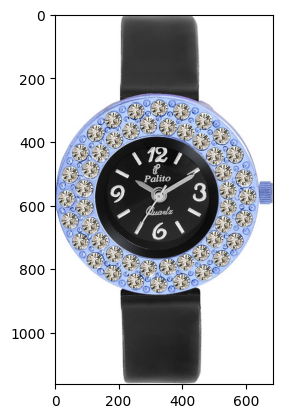

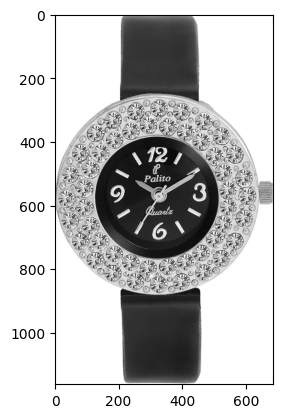

In [221]:
# Open and convert one image in the GRAYSCALE format
img = cv.imread(filename=filenames[0])
gray_img= cv.cvtColor(img,cv.COLOR_BGR2GRAY)

print(img.shape)
plt.imshow(img)
plt.show()
plt.imshow(gray_img, cmap='gray', vmin=0, vmax=255)
plt.show()

Number of keypoints Detected: 300 



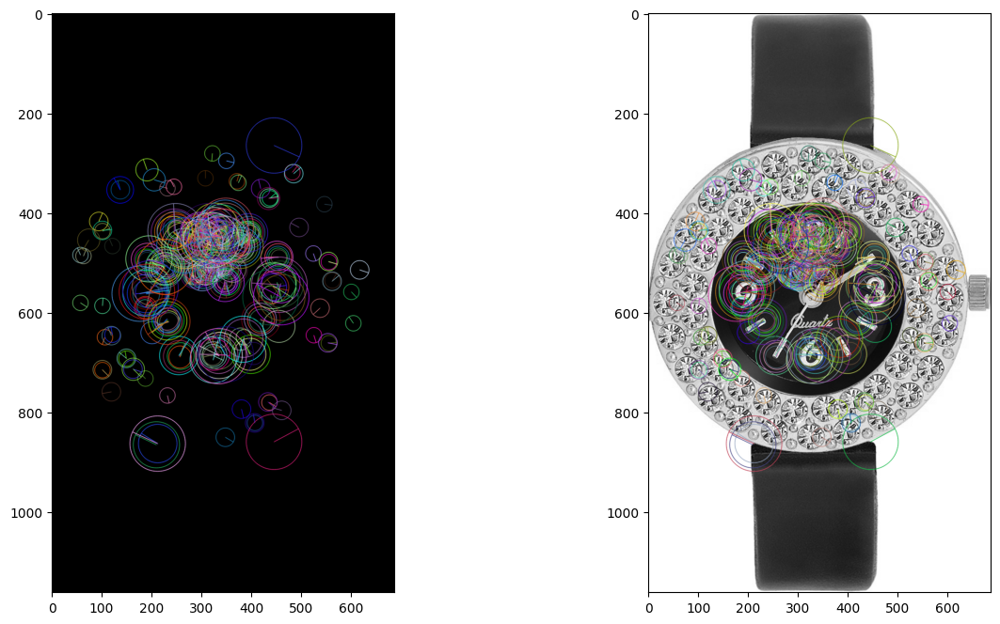

In [222]:
# Initiate detectors
sift = cv.SIFT_create()
orb = cv.ORB_create(nfeatures=300)

# Find the keypoints with SIFT
keypoints = orb.detect(gray_img, None)

# Print number of keypoints detected
print("Number of keypoints Detected:", len(keypoints), "\n")

# Creating a black image to display the keypoints
black_img = np.zeros((img.shape[0], img.shape[1]), np.uint8) 

# Drawing keypoints on a black image
black_kp = cv.drawKeypoints(image=black_img,
                            keypoints=keypoints,
                            outImage=0,
                            flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

img_kp = cv.drawKeypoints(image=gray_img,
                          keypoints=keypoints,
                          outImage=0,
                          flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

fig, ax = plt.subplots(1, 2, figsize=(15, 8))
ax[0].imshow(black_kp)
ax[1].imshow(img_kp)
plt.show()

In [223]:
# Compute descriptors
_, descriptors = orb.compute(gray_img, keypoints)
descriptors.shape

(300, 32)

# 3.  [&#9650;](#toc0_) <a id='toc3_'></a> ORB descriptors on all the images in the dataset.

## 3.1.  [&#9650;](#toc0_) <a id='toc3_1_'></a>Generation

In [224]:
from tqdm import tqdm
# List which will receive all descriptors of all images 
# to fit a clusterer and map each descriptor to a class.
descriptors_list = []

# Limit to the main 'nfeatures' descriptors per image.
orb = cv.ORB_create(nfeatures=250)

for filename in tqdm(filenames):
    # Read image and convert to gray
    img = cv.imread(filename=filename)
    img = cv.cvtColor(img,cv.COLOR_BGR2GRAY)
    
    # Resize without changing shape
    img = pt.resize_based_on_lowest_dimension(img, n_pixels=200)
        
    # Find the keypoints with ORB
    _, descriptors = orb.detectAndCompute(img, None)
    descriptors_list.append(descriptors)

100%|██████████| 1050/1050 [00:43<00:00, 23.95it/s]


## 3.2.  [&#9650;](#toc0_) <a id='toc3_2_'></a>Exploration

In [225]:
# Make some metadata on descriptors
n_descriptors = []

for desc in descriptors_list:
    if desc is None:
        n_descriptors.append(0)
    else:
        n_descriptors.append(desc.shape[0])

metadata['n_descriptors'] = n_descriptors
metadata.head()

,image,shape,n_pixels,mean_gray,min_gray,max_gray,category,n_descriptors
0,009099b1f6e1e8f893ec29a7023153c4.jpg,"(1162, 687, 3)",798294,172.415863,0,255,watches,230
1,0096e89cc25a8b96fb9808716406fe94.jpg,"(904, 1478, 3)",1336112,156.565580,0,255,kitchen_&_dining,207
2,00cbbc837d340fa163d11e169fbdb952.jpg,"(326, 1347, 3)",439122,192.004357,9,255,home_furnishing,133
3,00d84a518e0550612fcfcba3b02b6255.jpg,"(857, 1100, 3)",942700,168.342569,0,255,beauty_and_personal_care,208
4,00e966a5049a262cfc72e6bbf68b80e7.jpg,"(1100, 962, 3)",1058200,171.585655,3,255,computers,164


In [226]:
metadata.n_descriptors.describe()

count    1050.000000
mean      189.573333
std        48.375821
min         0.000000
25%       184.000000
50%       206.000000
75%       220.000000
max       234.000000
Name: n_descriptors, dtype: float64

Some images have no descriptors.

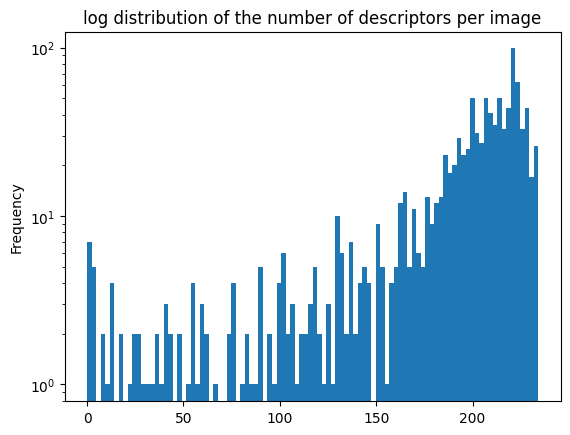

In [227]:
metadata.n_descriptors.plot(kind='hist', bins=100, log=True)
plt.title('log distribution of the number of descriptors per image')
plt.show()

### 3.2.1.  [&#9650;](#toc0_) <a id='toc3_2_1_'></a>images with no keypoints

In [228]:
no_descriptor = metadata.query('n_descriptors == 0')
no_descriptor

,image,shape,n_pixels,mean_gray,min_gray,max_gray,category,n_descriptors
513,7c785e9e26092c0b6ed038085e90d89d.jpg,"(320, 936, 3)",299520,138.835516,0,255,home_furnishing,0
635,9743e6d1c9f3180483825fe4d2e97836.jpg,"(541, 534, 3)",288894,243.698123,220,255,computers,0
702,a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg,"(1428, 1130, 3)",1613640,76.625543,0,255,baby_care,0
820,c5720509a67da707afcb6f4f0282d529.jpg,"(1022, 1393, 3)",1423646,254.087186,0,255,computers,0
833,c8e2c85eccdc9db55eeb2231385e4f1c.jpg,"(1100, 381, 3)",419100,245.331656,99,255,computers,0
941,e426290a8f57e82680275bb91df91ad1.jpg,"(1100, 1019, 3)",1120900,245.883445,9,255,computers,0
975,eedee8680f0ed35dcf612c6774affe83.jpg,"(1635, 1900, 3)",3106500,233.228091,0,255,computers,0


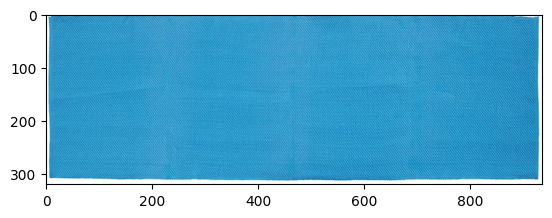

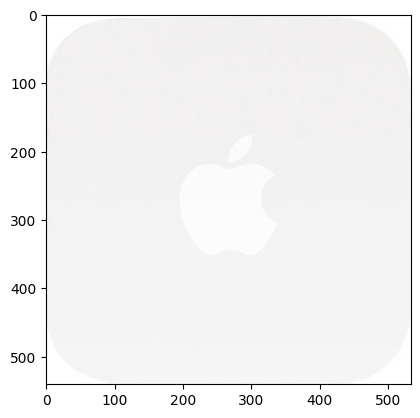

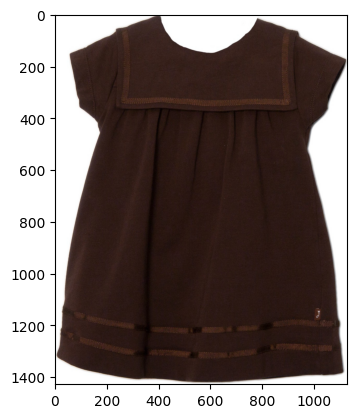

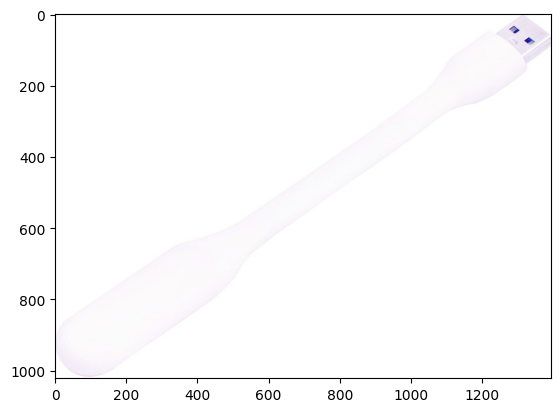

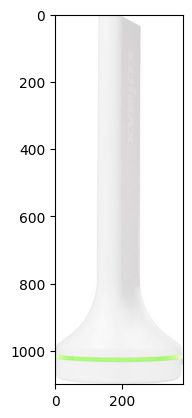

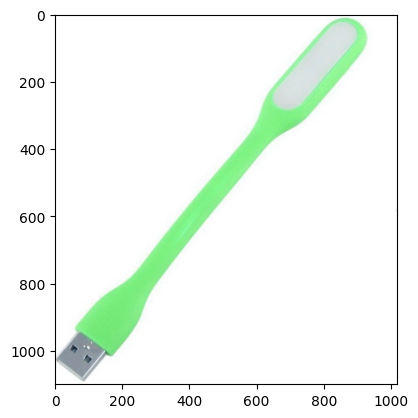

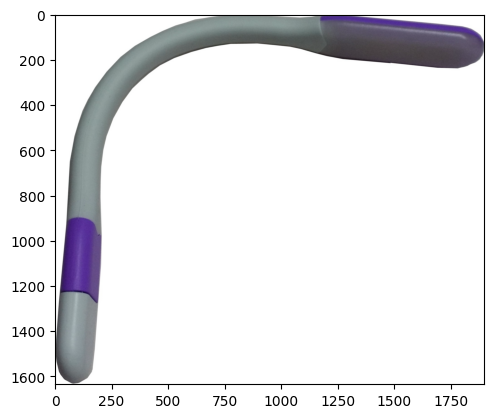

In [229]:
# Visualize images with no descriptors
image_dir = './data/Flipkart/Images/'

for name in no_descriptor.image:
    fig = plt.figure()
    img = cv.imread(image_dir + name)
    plt.imshow(img)

Here are the images without descriptors, and I will want to understand why they have no descriptors in the next section.

 But first, let's see if we can start classifying with those features.

In [230]:
# Add descriptors filled with zeros for images with no descriptors
idx_pb = no_descriptor.index
for idx in idx_pb:
    descriptors_list[idx] = np.zeros((1,32))

In [231]:
# Create a matrix of all descriptors
all_descriptors = np.vstack(descriptors_list)
all_descriptors.shape

(199059, 32)

## 3.3.  [&#9650;](#toc0_) <a id='toc3_3_'></a>Create image vectors

### 3.3.1.  [&#9650;](#toc0_) <a id='toc3_3_1_'></a>Finding visual words

In [232]:
n_clusters = 85

from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import KMeans

# kmeans = KMeans(n_clusters=n_clusters, n_init=5)
kmeans = MiniBatchKMeans(
    n_clusters=n_clusters,
    batch_size=1024,
    n_init=5
)

kmeans.fit(all_descriptors)


MiniBatchKMeans(n_clusters=85, n_init=5)

## 3.4.  [&#9650;](#toc0_) <a id='toc3_4_'></a>Build the image vector for the first image

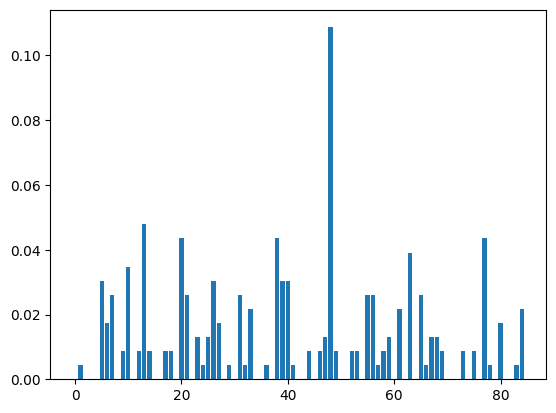

array([0.        , 0.00434783, 0.        , 0.        , 0.        ,
       0.03043478, 0.0173913 , 0.02608696, 0.        , 0.00869565,
       0.03478261, 0.        , 0.00869565, 0.04782609, 0.00869565,
       0.        , 0.        , 0.00869565, 0.00869565, 0.        ,
       0.04347826, 0.02608696, 0.        , 0.01304348, 0.00434783,
       0.01304348, 0.03043478, 0.0173913 , 0.        , 0.00434783,
       0.        , 0.02608696, 0.00434783, 0.02173913, 0.        ,
       0.        , 0.00434783, 0.        , 0.04347826, 0.03043478,
       0.03043478, 0.00434783, 0.        , 0.        , 0.00869565,
       0.        , 0.00869565, 0.01304348, 0.10869565, 0.00869565,
       0.        , 0.        , 0.00869565, 0.00869565, 0.        ,
       0.02608696, 0.02608696, 0.00434783, 0.00869565, 0.01304348,
       0.        , 0.02173913, 0.        , 0.03913043, 0.        ,
       0.02608696, 0.00434783, 0.01304348, 0.01304348, 0.00869565,
       0.        , 0.        , 0.        , 0.00869565, 0.     

In [233]:
img_descriptors = descriptors_list[0]

img_vect = pt.create_image_vector_from_descriptors(
    img_descriptors,
    kmeans,
)
        
plt.bar(range(n_clusters), img_vect)
plt.show()
img_vect

## 3.5.  [&#9650;](#toc0_) <a id='toc3_5_'></a>Image vectors on the full dataset.

In [234]:
from collections import defaultdict

histo = defaultdict()
myzip = zip(descriptors_list, metadata.image,)

for img_descriptors, image_name in tqdm(myzip):
    histo[image_name] = pt.create_image_vector_from_descriptors(
        img_descriptors=img_descriptors,
        fit_kmeans=kmeans,
    )
    
    

1050it [00:00, 1632.18it/s]


In [235]:
image_vectors = pd.DataFrame(
    histo,
    index=[f'feature_class_{k}' for k in range(n_clusters)]
).T

image_vectors.head()

,feature_class_0,feature_class_1,feature_class_2,feature_class_3,feature_class_4,feature_class_5,feature_class_6,feature_class_7,feature_class_8,feature_class_9,...,feature_class_75,feature_class_76,feature_class_77,feature_class_78,feature_class_79,feature_class_80,feature_class_81,feature_class_82,feature_class_83,feature_class_84
009099b1f6e1e8f893ec29a7023153c4.jpg,0.000000,0.004348,0.000000,0.000000,0.000000,0.030435,0.017391,0.026087,0.000000,0.008696,...,0.008696,0.000000,0.043478,0.004348,0.000000,0.017391,0.000000,0.000000,0.004348,0.021739
0096e89cc25a8b96fb9808716406fe94.jpg,0.000000,0.014493,0.000000,0.000000,0.019324,0.120773,0.033816,0.057971,0.009662,0.057971,...,0.004831,0.000000,0.000000,0.009662,0.000000,0.000000,0.000000,0.004831,0.000000,0.014493
00cbbc837d340fa163d11e169fbdb952.jpg,0.127820,0.000000,0.120301,0.037594,0.000000,0.000000,0.000000,0.000000,0.030075,0.000000,...,0.000000,0.000000,0.007519,0.007519,0.030075,0.000000,0.000000,0.000000,0.000000,0.000000
00d84a518e0550612fcfcba3b02b6255.jpg,0.009615,0.014423,0.019231,0.019231,0.019231,0.000000,0.000000,0.000000,0.004808,0.000000,...,0.024038,0.014423,0.004808,0.009615,0.009615,0.014423,0.024038,0.014423,0.019231,0.004808
00e966a5049a262cfc72e6bbf68b80e7.jpg,0.006098,0.000000,0.048780,0.012195,0.012195,0.000000,0.018293,0.000000,0.006098,0.012195,...,0.012195,0.000000,0.018293,0.000000,0.018293,0.006098,0.000000,0.000000,0.006098,0.012195


In [236]:
X = image_vectors.values

In [237]:
X.shape

(1050, 85)

79
2
5
8
10
15
30


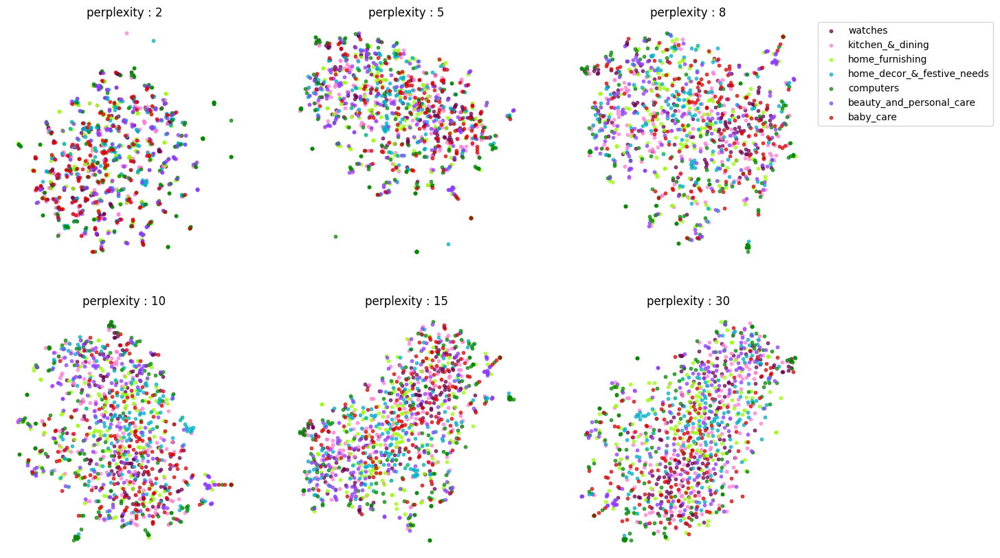

In [238]:
# Reduce information and compute t-SNE
pca = PCA(n_components=0.99)
X_pca = pca.fit_transform(X)
print(pca.n_components_)

ds.find_tsne_best_perplexity(
    X_pca,
    perplexities=[2, 5, 8, 10, 15, 30],
    labels=metadata.category,
)

In [239]:
kmeans = KMeans(n_clusters=7, n_init=5)
pca = PCA(n_components=0.8)
svd = TruncatedSVD(n_components=20)
tsne = TSNE(n_components=2, perplexity=8)

pipelines = {
    'kmeans': make_pipeline(kmeans),
    'svd_kmeans': make_pipeline(svd, kmeans),
    'pca_kmeans': make_pipeline(pca, kmeans),
    'tsne_kmeans': make_pipeline(tsne, kmeans),
}


true_labels = metadata.category

# Results containers
evaluations = []
evaluations_std = []

for pipe_name, pipe in pipelines.items():
    
    model_name = (
        pipe_name 
        + '\non ORB v1 histograms'
        + '\nvoc :200'
    )
    
    print('***********')
    print(model_name)
    ds.fit_and_evaluate_clusters(
        model=pipe,
        X=X,
        labels=true_labels,
        name=model_name,
        evaluations=evaluations,
        evaluations_std=evaluations_std,
    ) 

***********
kmeans
on ORB v1 histograms
voc :200
clustering done in 0.44 ± 0.09 s 
Homogeneity: 0.038 ± 0.005
Completeness: 0.053 ± 0.006
V-measure: 0.044 ± 0.005
Adjusted Rand-Index: 0.014 ± 0.003
Silhouette: 0.066 ± 0.008
***********
svd_kmeans
on ORB v1 histograms
voc :200
clustering done in 0.77 ± 0.07 s 
Homogeneity: 0.035 ± 0.003
Completeness: 0.049 ± 0.005
V-measure: 0.041 ± 0.004
Adjusted Rand-Index: 0.013 ± 0.002
Silhouette: 0.062 ± 0.010
***********
pca_kmeans
on ORB v1 histograms
voc :200
clustering done in 0.44 ± 0.04 s 
Homogeneity: 0.038 ± 0.006
Completeness: 0.053 ± 0.006
V-measure: 0.044 ± 0.006
Adjusted Rand-Index: 0.015 ± 0.002
Silhouette: 0.069 ± 0.005
***********
tsne_kmeans
on ORB v1 histograms
voc :200
clustering done in 6.51 ± 0.91 s 
Homogeneity: 0.042 ± 0.009
Completeness: 0.042 ± 0.010
V-measure: 0.042 ± 0.009
Adjusted Rand-Index: 0.022 ± 0.007
Silhouette: -0.036 ± 0.006


Here we have bad scores, confirming the visual impression.

# 4.  [&#9650;](#toc0_) <a id='toc4_'></a>Exploring pre-processing and parameters influences on the ORB keypoints detection.

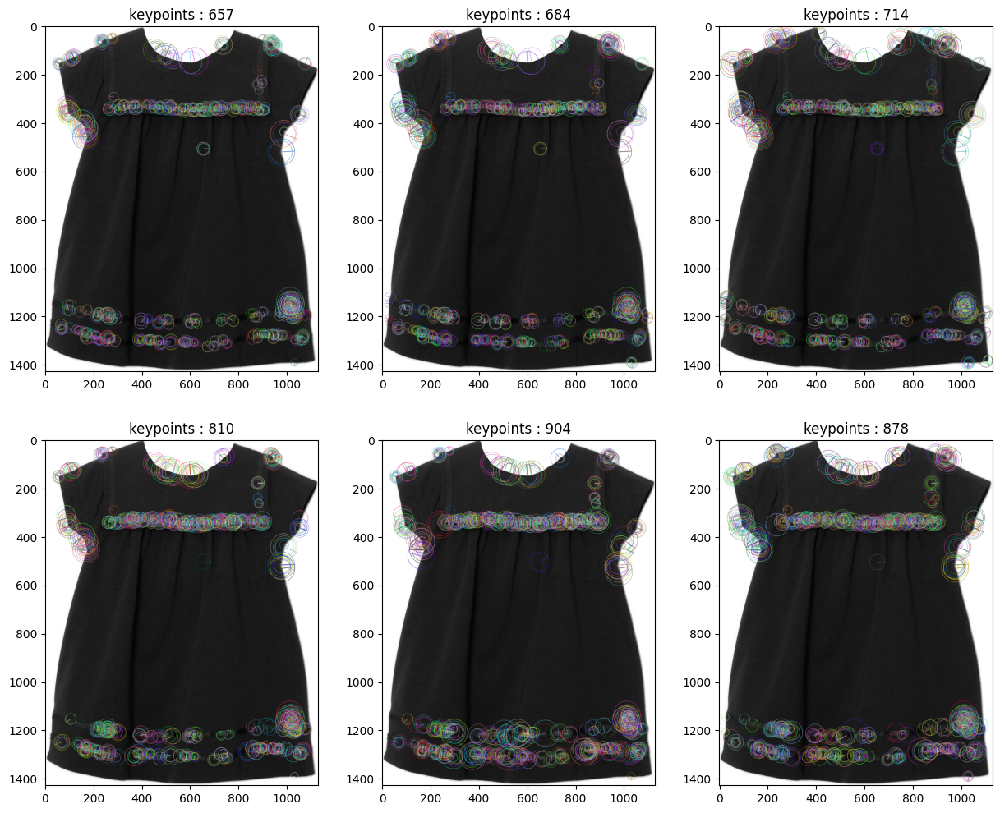

In [61]:
# Exploring ORB parameters on the original size image
image_dir = './data/Flipkart/Images/'
name = 'a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg'
img_ = cv.imread(image_dir + name)
# img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=200)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)

orb1 = cv.ORB_create(nfeatures=1000, edgeThreshold=31)
orb2 = cv.ORB_create(nfeatures=1000, edgeThreshold=23)
orb3 = cv.ORB_create(nfeatures=1000, edgeThreshold=15)
orb4 = cv.ORB_create(nfeatures=1000, fastThreshold=13)
orb5 = cv.ORB_create(nfeatures=1000, fastThreshold=10)
orb6 = cv.ORB_create(nfeatures=1000, edgeThreshold=23, fastThreshold=12)


orbs = [eval('orb' + str(k)) for k in range(1,7)]

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

With the original image size, we get plenty of nice keypoints.

The ORB parameters do not introduce really important new keypoints although the number is increasing.

## 4.1.  [&#9650;](#toc0_) <a id='toc4_1_'></a>ORB parameters on a resized image

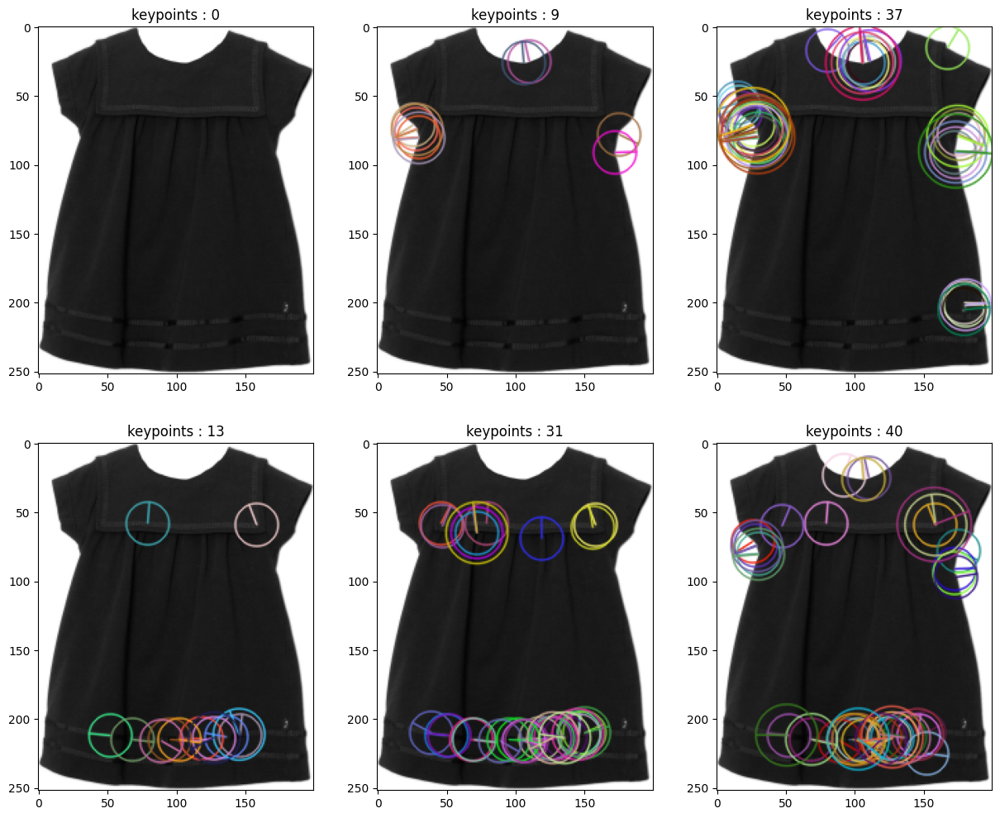

In [27]:
image_dir = './data/Flipkart/Images/'
name = 'a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg'
img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=200)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)

orb1 = cv.ORB_create(nfeatures=1000, edgeThreshold=31)
orb2 = cv.ORB_create(nfeatures=1000, edgeThreshold=23)
orb3 = cv.ORB_create(nfeatures=1000, edgeThreshold=15)
orb4 = cv.ORB_create(nfeatures=1000, fastThreshold=13)
orb5 = cv.ORB_create(nfeatures=1000, fastThreshold=10)
orb6 = cv.ORB_create(nfeatures=1000, edgeThreshold=23, fastThreshold=12)


orbs = [eval('orb' + str(k)) for k in range(1,7)]

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

Resizing has a huge impact. 

I should not downsize too much even though it would cost more computation time because first results were much better than this.

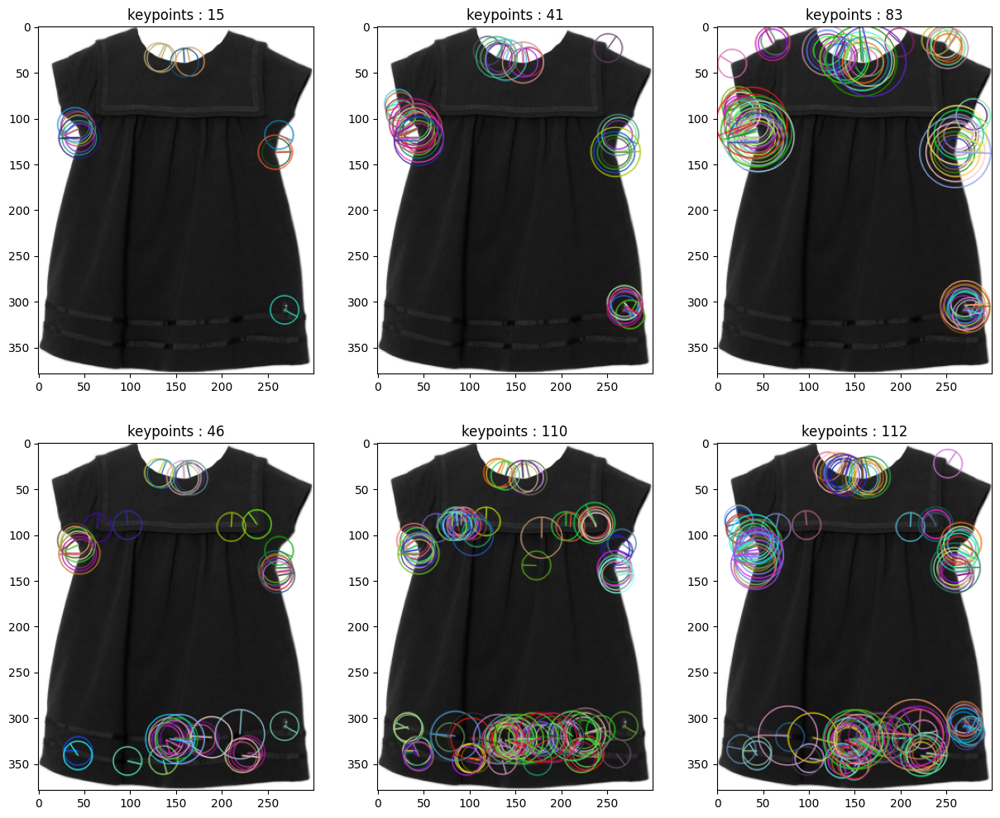

In [28]:
# downsizing to 300 pixels on the shortest dimension
image_dir = './data/Flipkart/Images/'
name = 'a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg'
img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=300)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)

orb1 = cv.ORB_create(nfeatures=1000, edgeThreshold=31)
orb2 = cv.ORB_create(nfeatures=1000, edgeThreshold=23)
orb3 = cv.ORB_create(nfeatures=1000, edgeThreshold=15)
orb4 = cv.ORB_create(nfeatures=1000, fastThreshold=13)
orb5 = cv.ORB_create(nfeatures=1000, fastThreshold=10)
orb6 = cv.ORB_create(nfeatures=1000, edgeThreshold=23, fastThreshold=12)


orbs = [eval('orb' + str(k)) for k in range(1,7)]

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

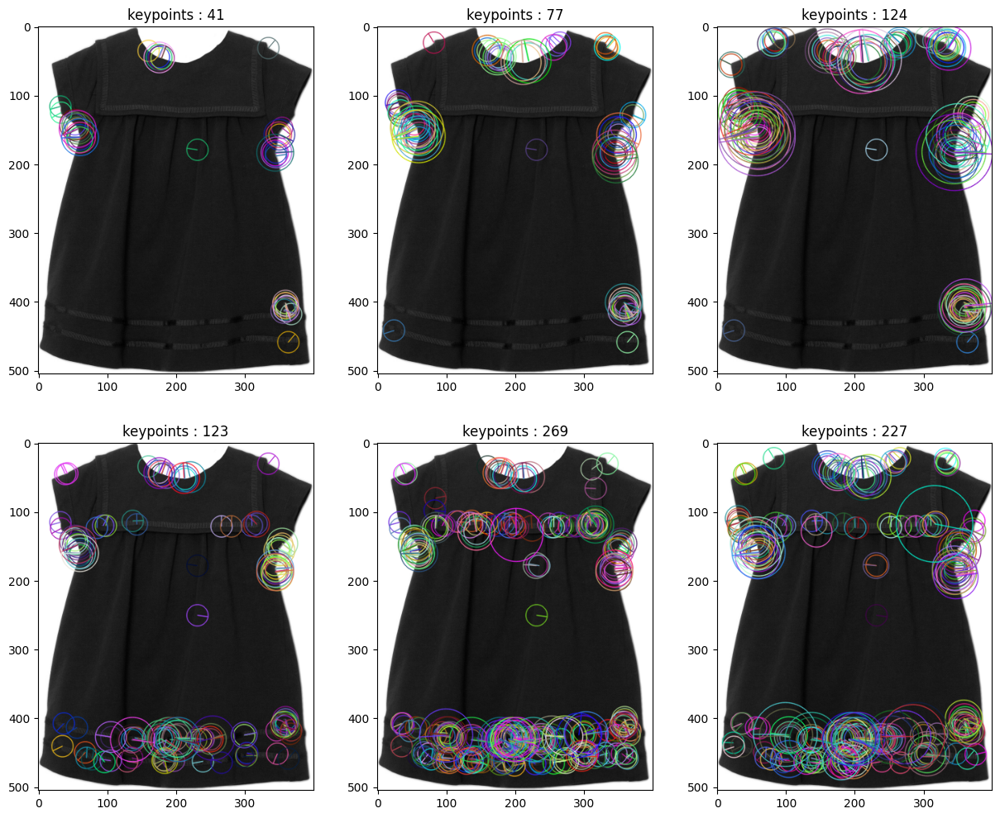

In [26]:
# downsizing to 400 pixels on the shortest dimension
image_dir = './data/Flipkart/Images/'
name = 'a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg'
img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=400)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)

orb1 = cv.ORB_create(nfeatures=1000, edgeThreshold=31)
orb2 = cv.ORB_create(nfeatures=1000, edgeThreshold=23)
orb3 = cv.ORB_create(nfeatures=1000, edgeThreshold=15)
orb4 = cv.ORB_create(nfeatures=1000, fastThreshold=13)
orb5 = cv.ORB_create(nfeatures=1000, fastThreshold=10)
orb6 = cv.ORB_create(nfeatures=1000, edgeThreshold=23, fastThreshold=12)


orbs = [eval('orb' + str(k)) for k in range(1,7)]

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

Here the fourth ORB configuration image seems to catch the best information.

Let's see what happens with other images.

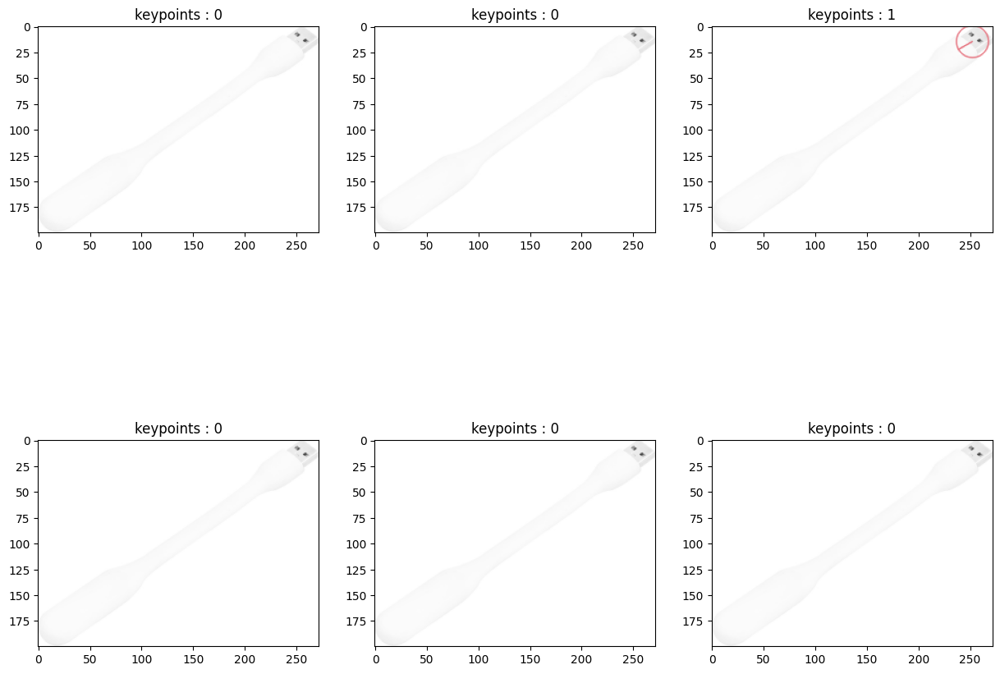

In [29]:
name = 'c5720509a67da707afcb6f4f0282d529.jpg'
img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=200)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

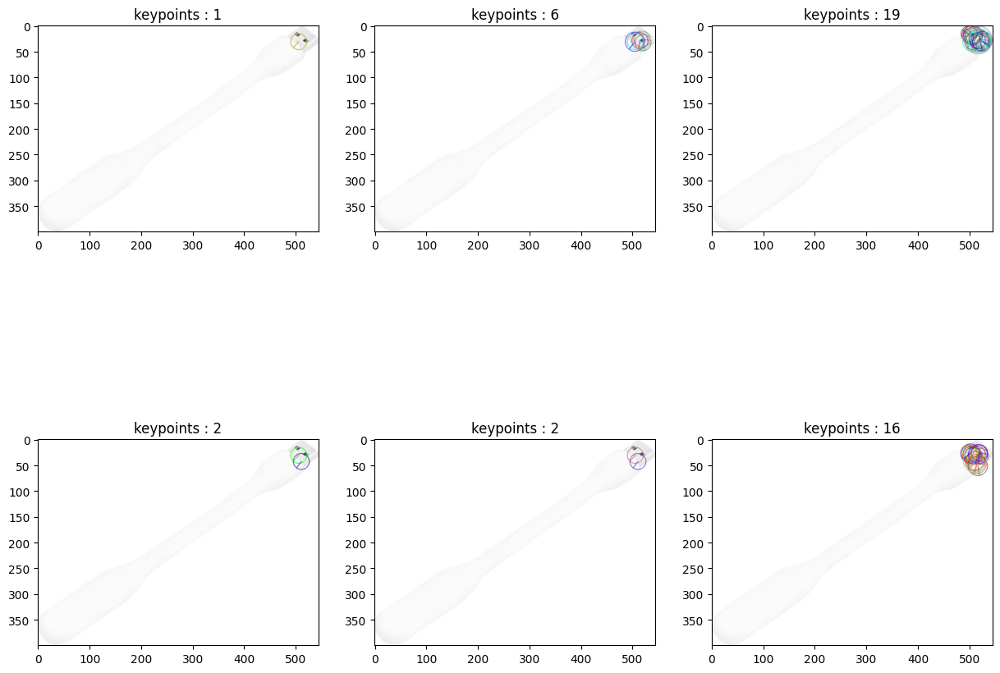

In [30]:
name = 'c5720509a67da707afcb6f4f0282d529.jpg'
img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=400)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

Upping the size does not help much in that case. May be more pre-processing such as histogram equalization can help.

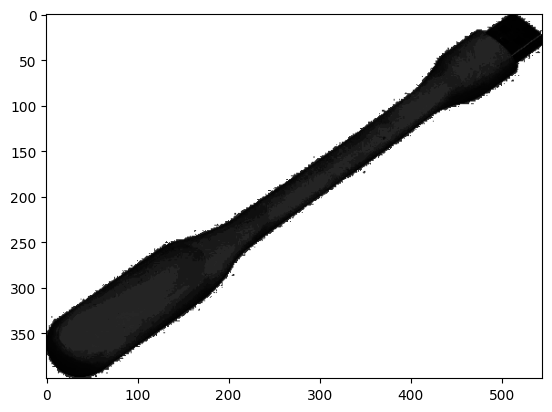

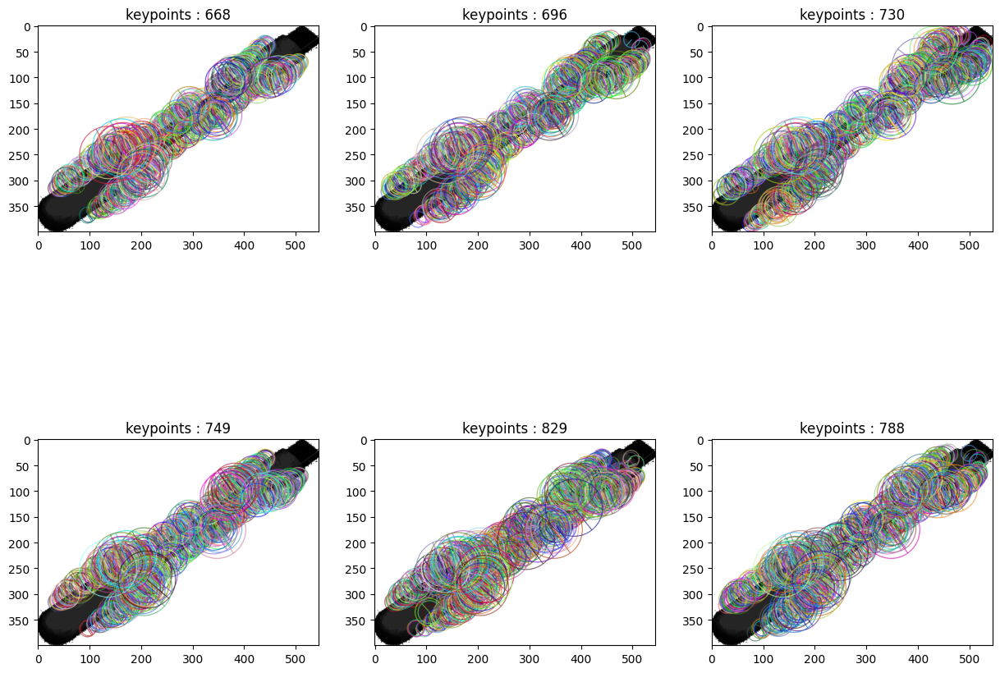

In [62]:
name = 'c5720509a67da707afcb6f4f0282d529.jpg'
img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=400)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)
# Increase contrasts.
gray_img_ = cv.equalizeHist(gray_img_)

plt.imshow(gray_img_, cmap='gray')
plt.show()

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

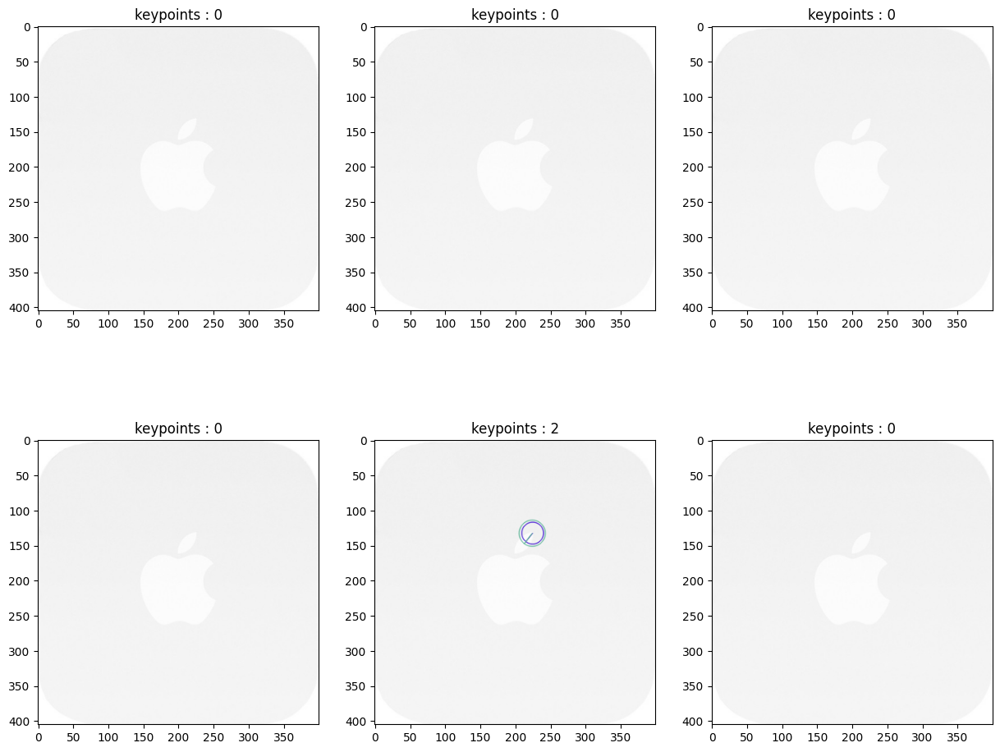

In [32]:
name = '9743e6d1c9f3180483825fe4d2e97836.jpg'

img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=400)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)
# Increase contrasts.
# gray_img_ = cv.equalizeHist(gray_img_)
fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

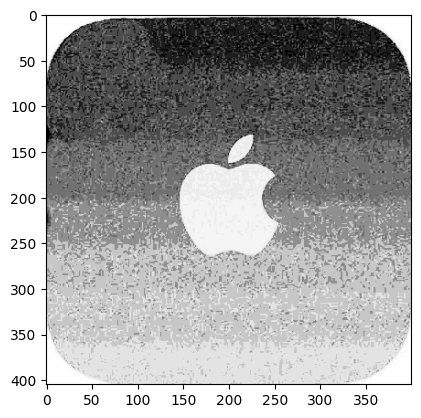

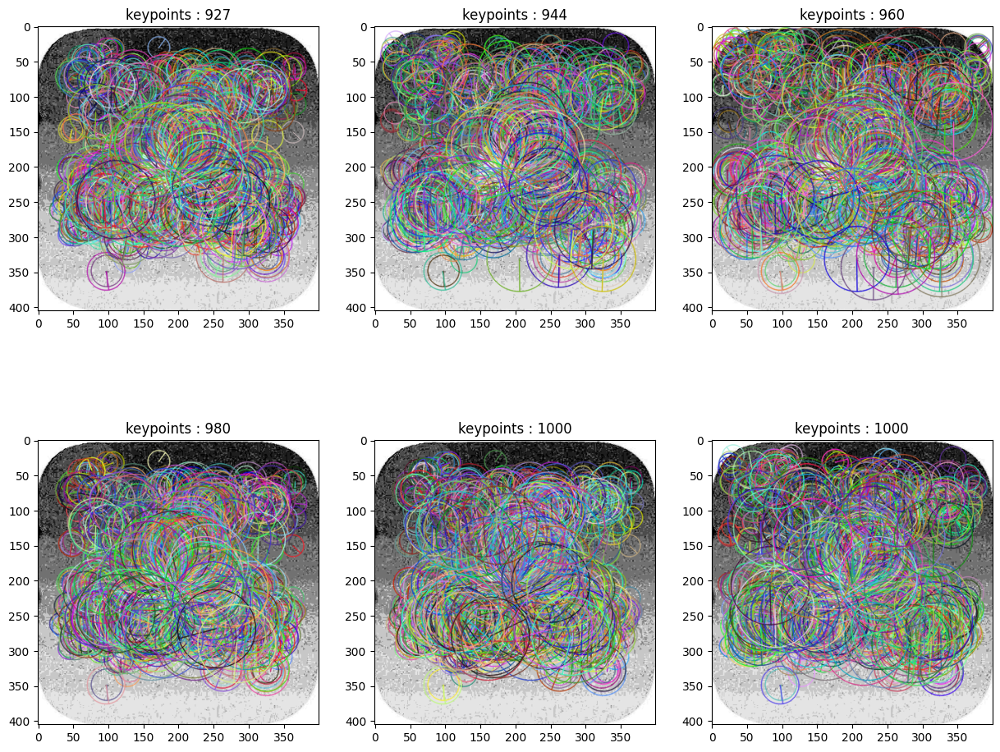

In [42]:
name = '9743e6d1c9f3180483825fe4d2e97836.jpg'

img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=400)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)
# Increase contrasts.
gray_img_ = cv.equalizeHist(gray_img_)

plt.imshow(gray_img_, cmap='gray')
plt.show()

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

When increasing the contrast, some noisy points come with.
A median filter could address that?

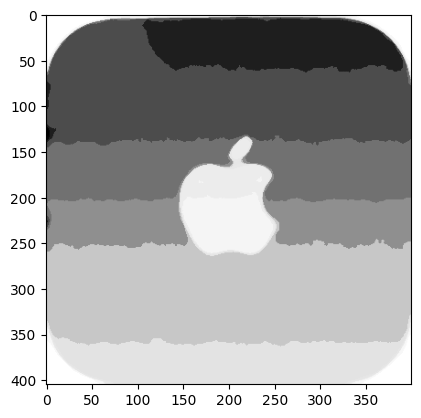

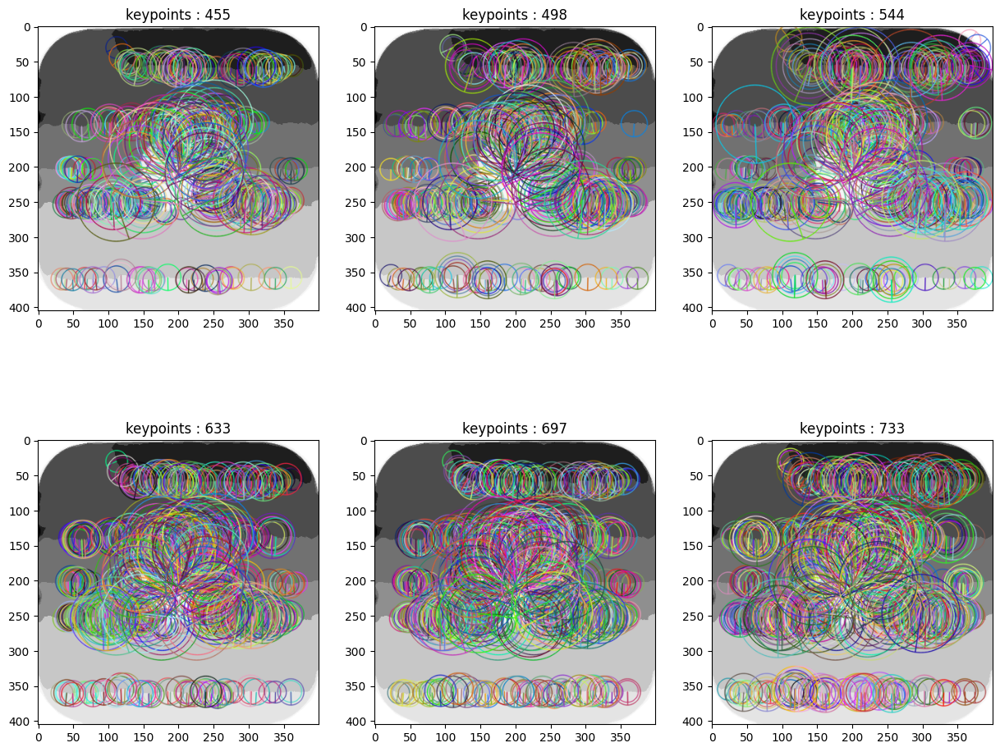

In [47]:
name = '9743e6d1c9f3180483825fe4d2e97836.jpg'

img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=400)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)
# Increase contrasts.
gray_img_ = cv.equalizeHist(gray_img_)
gray_img_ = cv.medianBlur(gray_img_, 15)
# gray_img_ = cv.bilateralFilter(gray_img_, 9,100,100)


plt.imshow(gray_img_, cmap='gray')
plt.show()

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

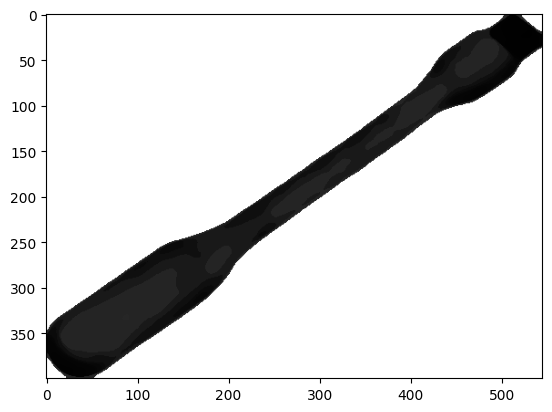

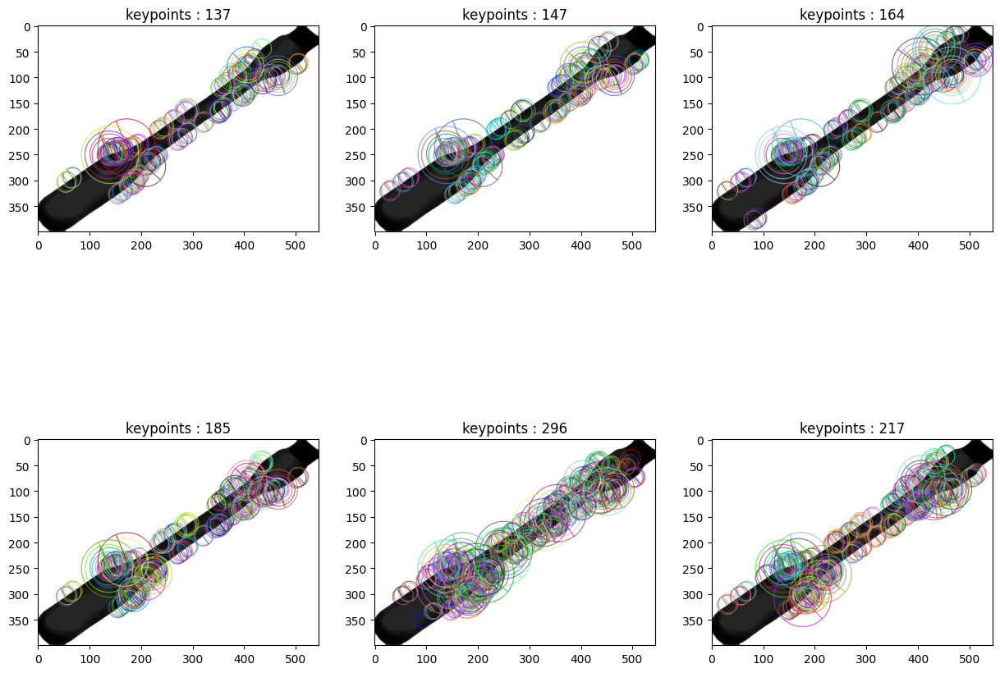

In [48]:
name = 'c5720509a67da707afcb6f4f0282d529.jpg'

img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=400)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)
# Increase contrasts.
gray_img_ = cv.equalizeHist(gray_img_)
gray_img_ = cv.medianBlur(gray_img_, 15)
# gray_img_ = cv.bilateralFilter(gray_img_, 9,100,100)


plt.imshow(gray_img_, cmap='gray')
plt.show()

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

When the contrast was low, after we changed it, the median filter helped in finding more interesting keypoints.

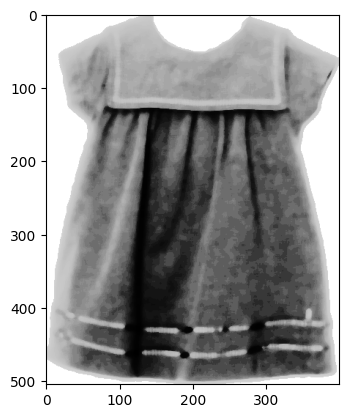

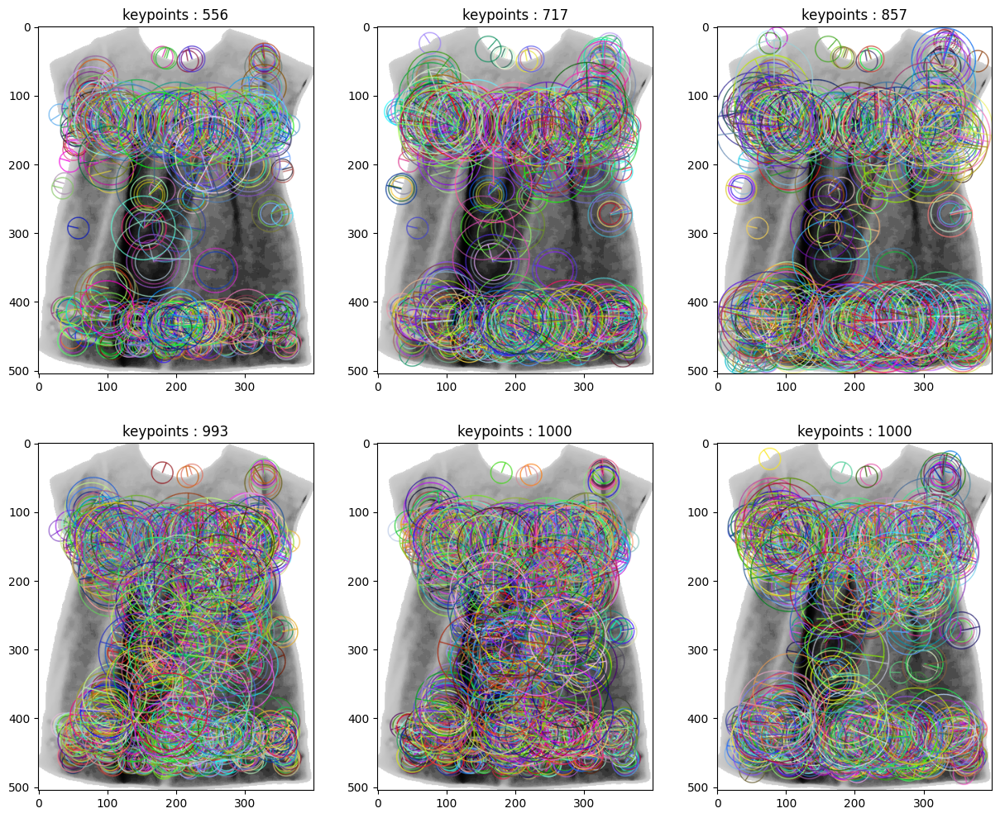

In [53]:
name = 'a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg'

img_ = cv.imread(image_dir + name)
img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=400)
gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)
# Increase contrasts.
gray_img_ = cv.equalizeHist(gray_img_)
gray_img_ = cv.medianBlur(gray_img_, 7)
# gray_img_ = cv.bilateralFilter(gray_img_, 9,100,100)


plt.imshow(gray_img_, cmap='gray')
plt.show()

fig, axes = plt.subplots(2, 3, figsize=(15, 12))

for ax, orb in zip(axes.flat, orbs):
    kp, desc = orb.detectAndCompute(gray_img_, None)
    img_kp = cv.drawKeypoints(image=gray_img_,
                              keypoints=kp,
                              outImage=0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    ax.imshow(img_kp)
    ax.set_title(f'keypoints : {len(kp)}')
plt.show()

Here forcing the equalization deteriorates results.

Let's see some random results we would get, if using / or not, the histogram equalization when the image size is greater.

In [76]:
# pick random images 
names = metadata.image.sample(5)

736191946aaeaa637a0865a42c18b580.jpg


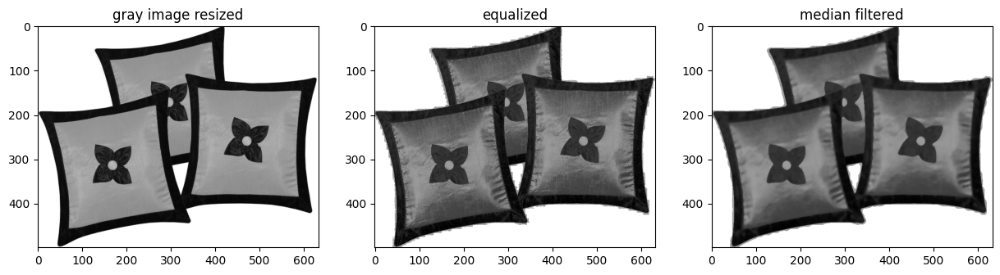

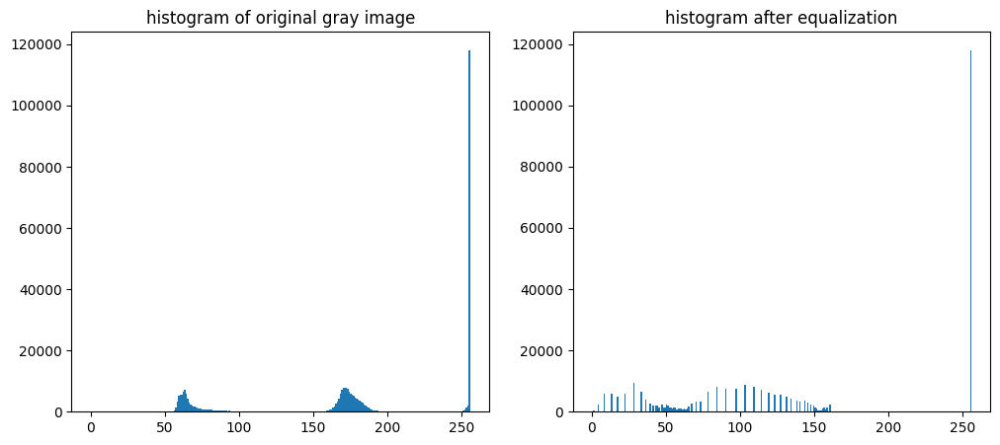

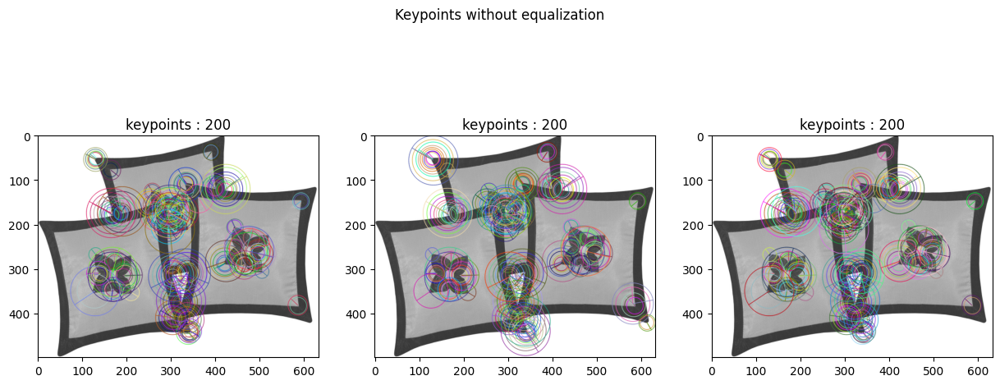

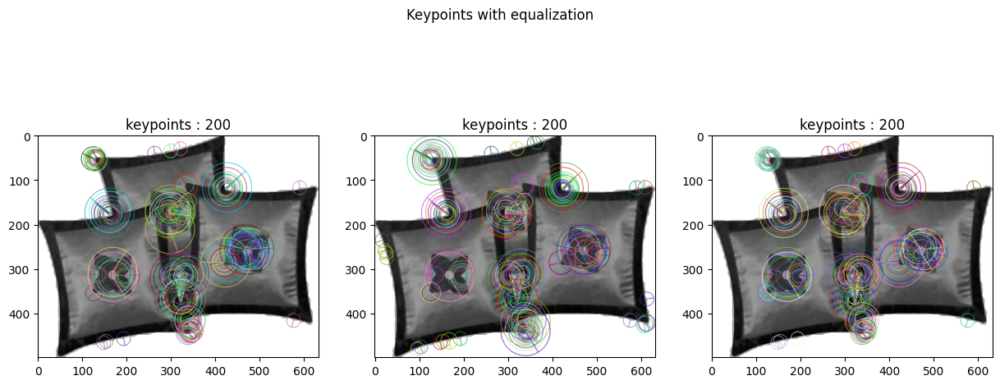

832a66ce379b4c98fd3d748eebd7ae4c.jpg


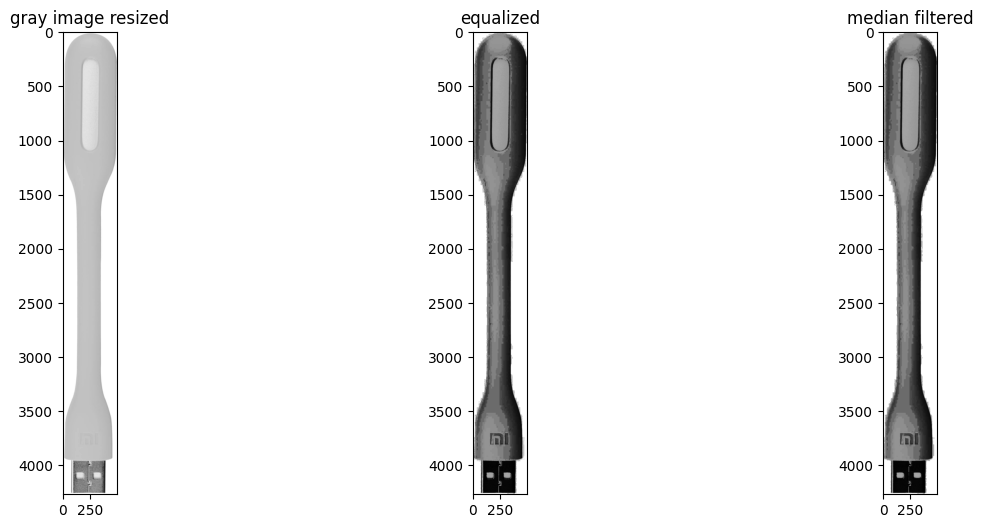

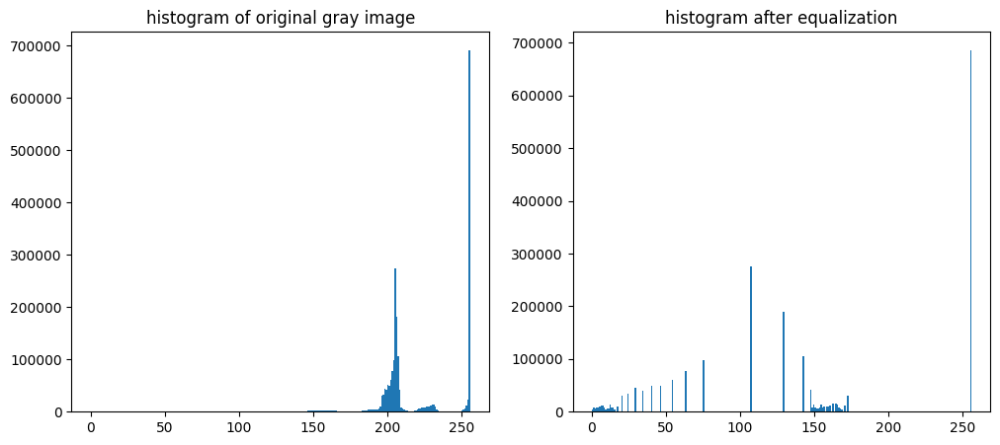

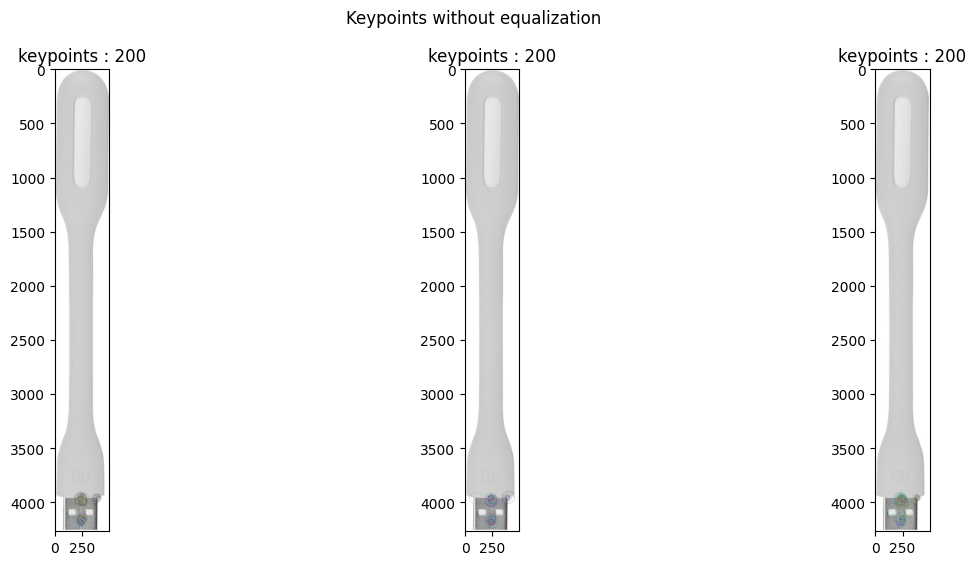

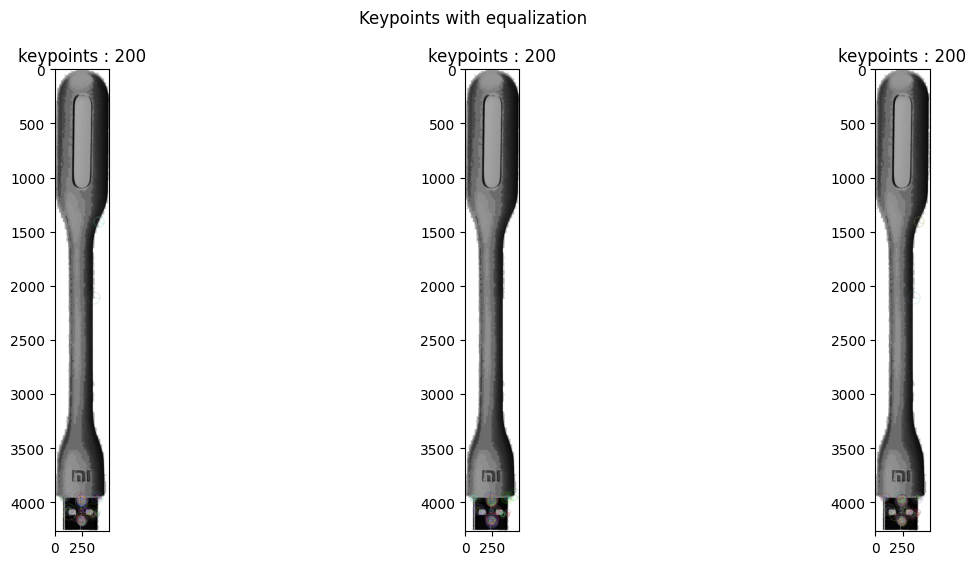

08452abdadb3db1e686b94a9c52fc7b6.jpg


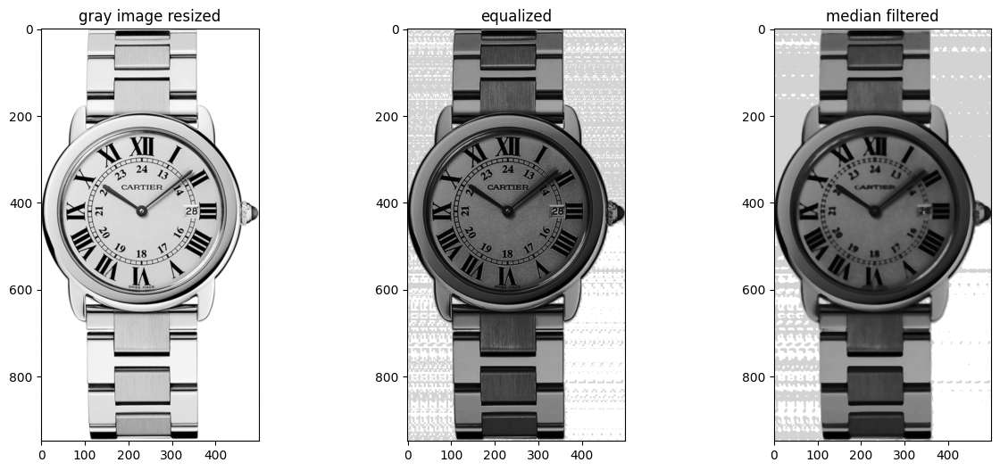

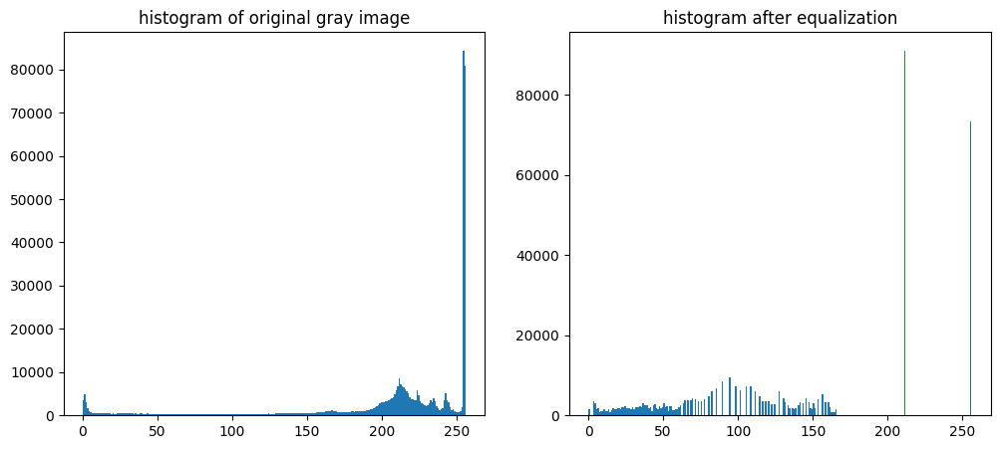

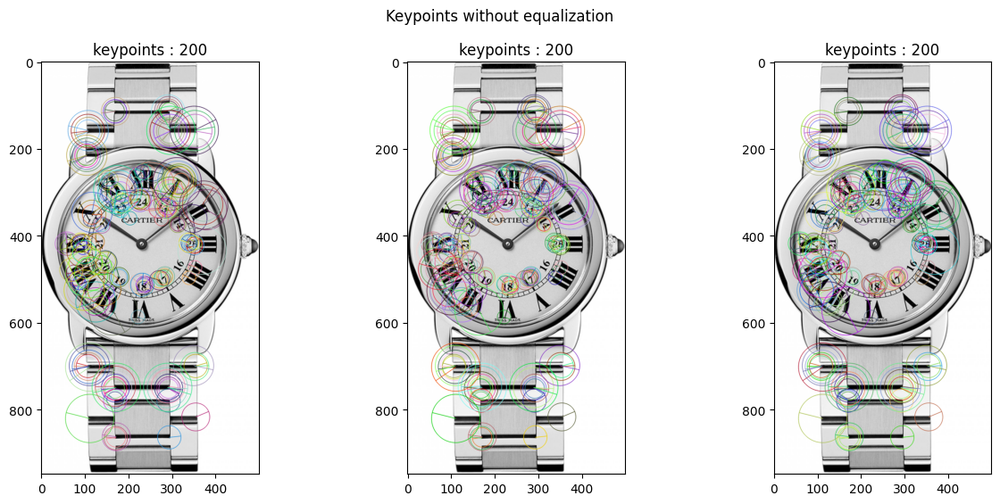

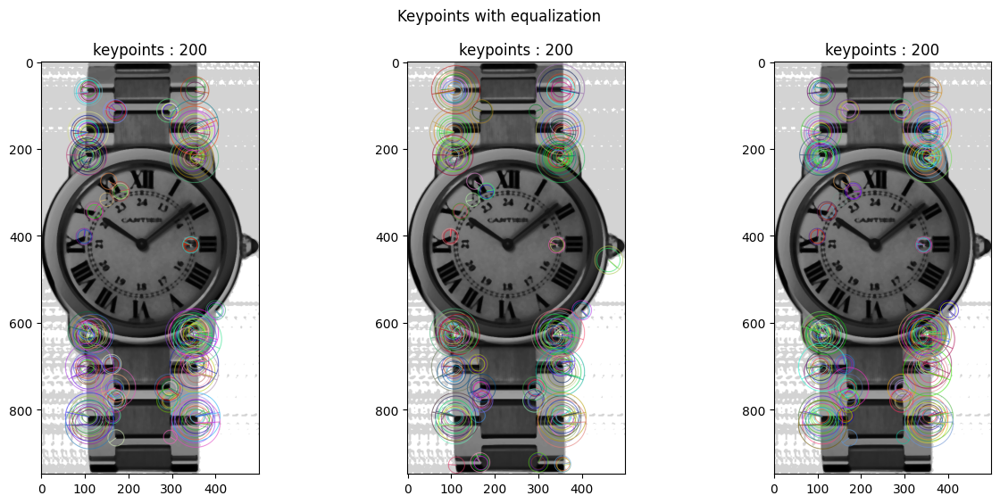

9743e6d1c9f3180483825fe4d2e97836.jpg


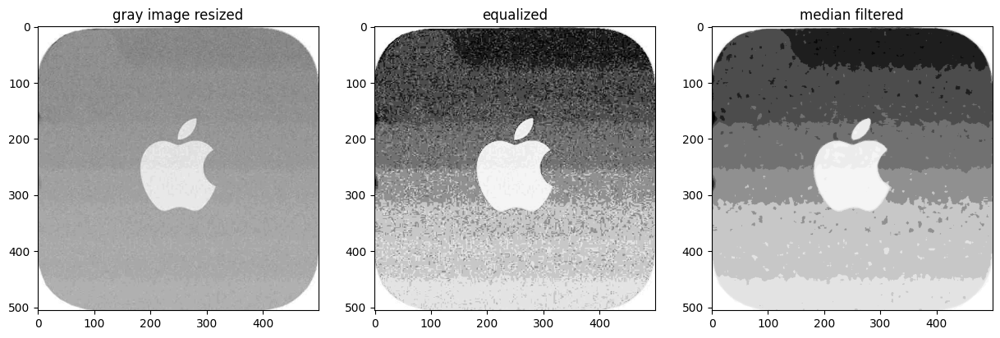

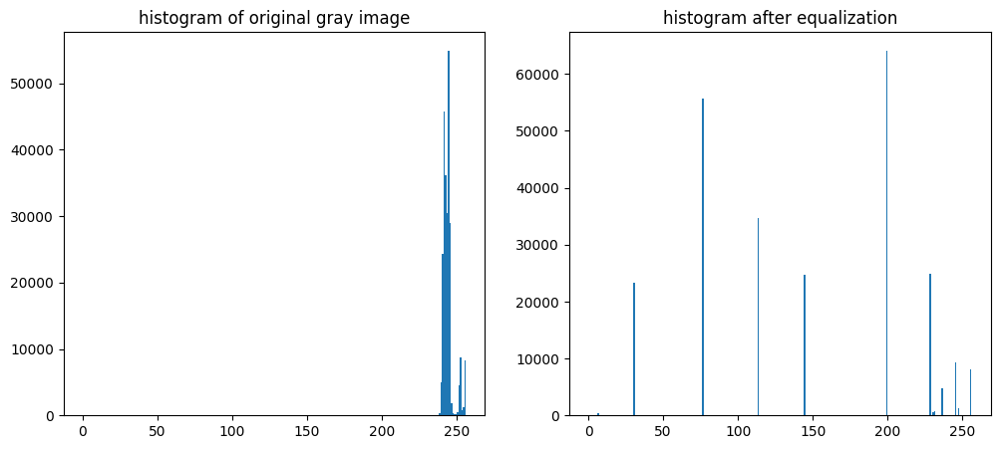

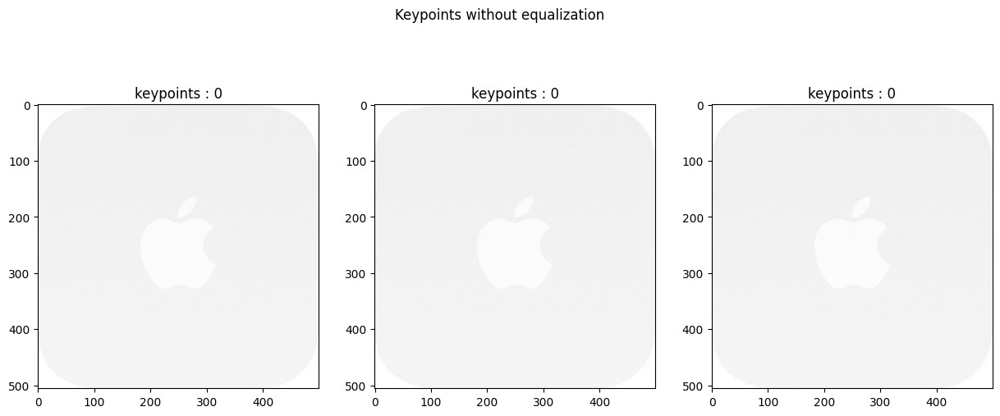

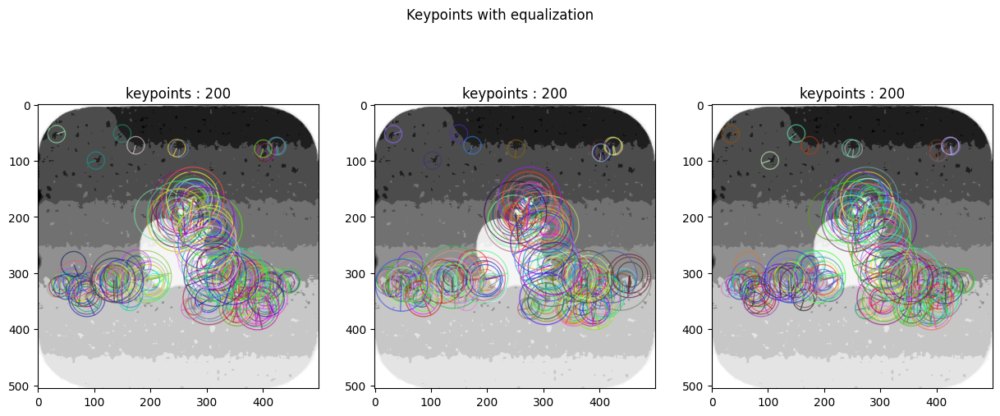

3b96a152c8fac4421fb67b6190584976.jpg


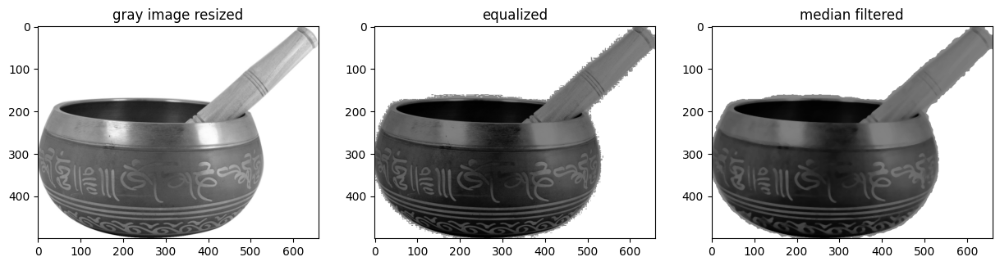

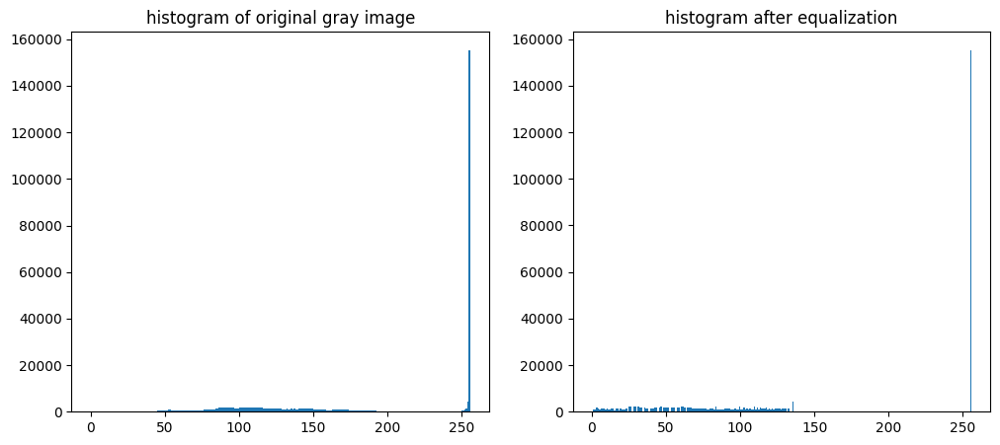

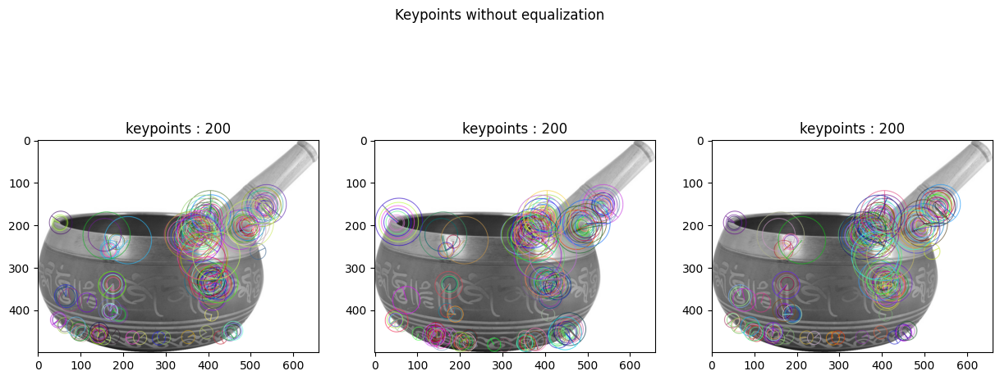

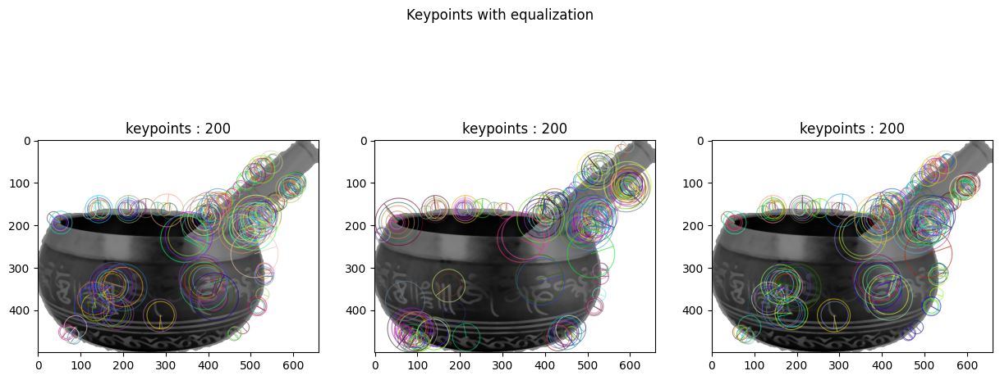

In [86]:
nfeatures = 200
n_pixels = 500

# Less ORB conf
orb1 = cv.ORB_create(nfeatures=nfeatures)
orb2 = cv.ORB_create(nfeatures=nfeatures, edgeThreshold=15)
orb3 = cv.ORB_create(nfeatures=nfeatures, fastThreshold=13)
orbs = [eval('orb' + str(k)) for k in range(1, 4)]

for name in names:
    print(name)
    img_ = cv.imread(image_dir + name)
    img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=n_pixels)
    gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)
    # Increase contrasts.
    gray_img_eq= cv.equalizeHist(gray_img_)
    gray_img_filt = cv.medianBlur(gray_img_eq, 7)
    # gray_img_ = cv.bilateralFilter(gray_img_, 9,100,100)

    fig, ax = plt.subplots(1, 3, figsize=(15,6))
    ax[0].imshow(gray_img_, cmap='gray')
    ax[0].set_title('gray image resized')
    ax[1].imshow(gray_img_eq, cmap='gray')
    ax[1].set_title('equalized')
    ax[2].imshow(gray_img_filt, cmap='gray')
    ax[2].set_title('median filtered')
    plt.show()
    
    fig, ax = plt.subplots(1, 2, figsize=(12,5))
    ax[0].hist(gray_img_.ravel(),256,[0,256])
    ax[0].set_title('histogram of original gray image')
    ax[1].hist(gray_img_filt.ravel(),256,[0,256])
    ax[1].set_title('histogram after equalization')
    # Plot results with the gray image
    fig, axes = plt.subplots(1, 3, figsize=(15, 6))

    for ax, orb in zip(axes.flat, orbs):
        kp, desc = orb.detectAndCompute(gray_img_, None)
        img_kp = cv.drawKeypoints(image=gray_img_,
                                  keypoints=kp,
                                  outImage=0,
                                  flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        ax.imshow(img_kp)
        ax.set_title(f'keypoints : {len(kp)}')
    plt.suptitle('Keypoints without equalization')    
    plt.show()
    
    # PLot results with hist equalization and median blurring.
    fig, axes = plt.subplots(1, 3, figsize=(15, 6))

    for ax, orb in zip(axes.flat, orbs):
        kp, desc = orb.detectAndCompute(gray_img_filt, None)
        img_kp = cv.drawKeypoints(image=gray_img_filt,
                                  keypoints=kp,
                                  outImage=0,
                                  flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        ax.imshow(img_kp)
        ax.set_title(f'keypoints : {len(kp)}')
    plt.suptitle('Keypoints with equalization')    
    plt.show()

It gives the impression that it is better with equalization anf filtering.

7037dbd17682322c89bdf7203b403381.jpg


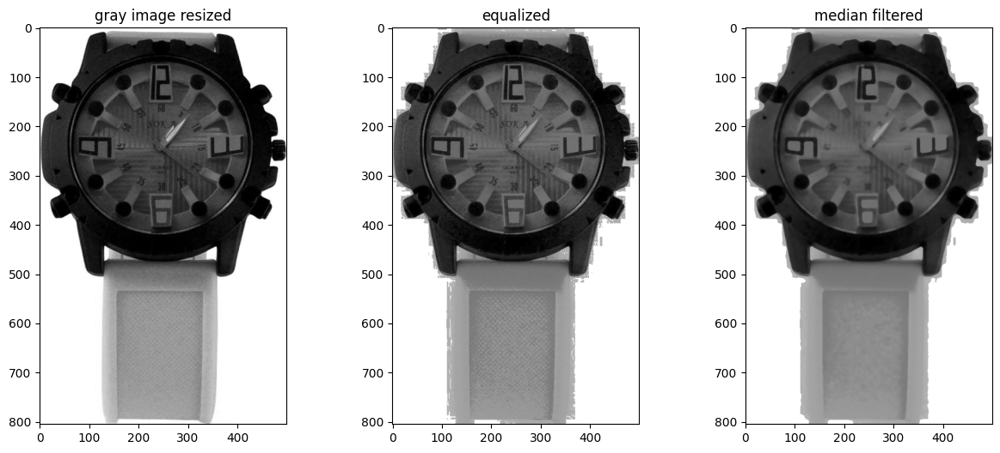

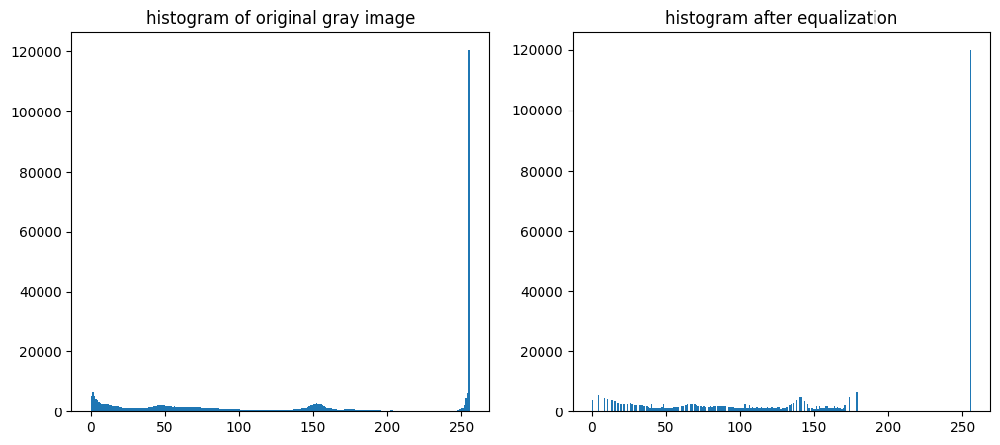

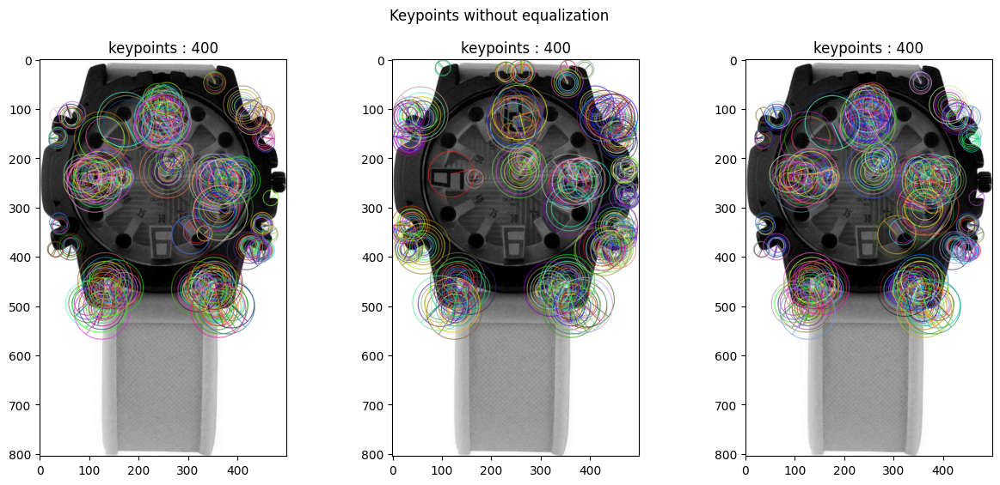

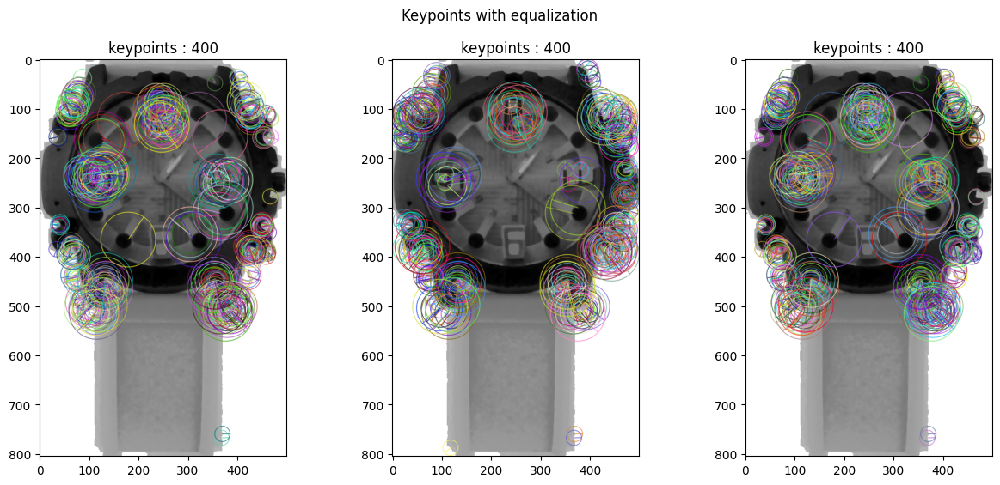

db6c79a1d852944a89e157793f392d67.jpg


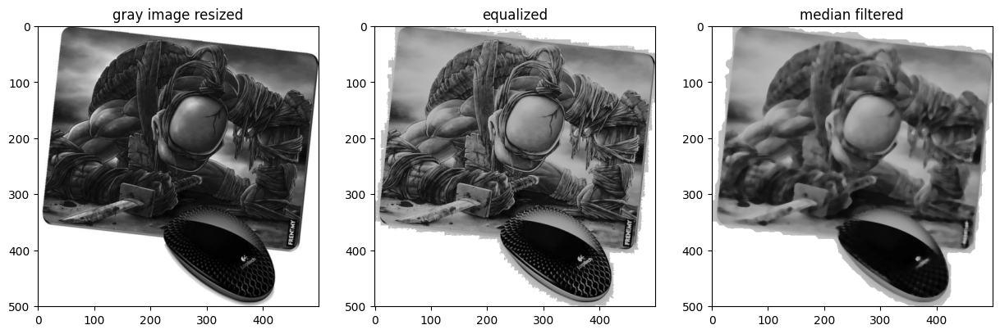

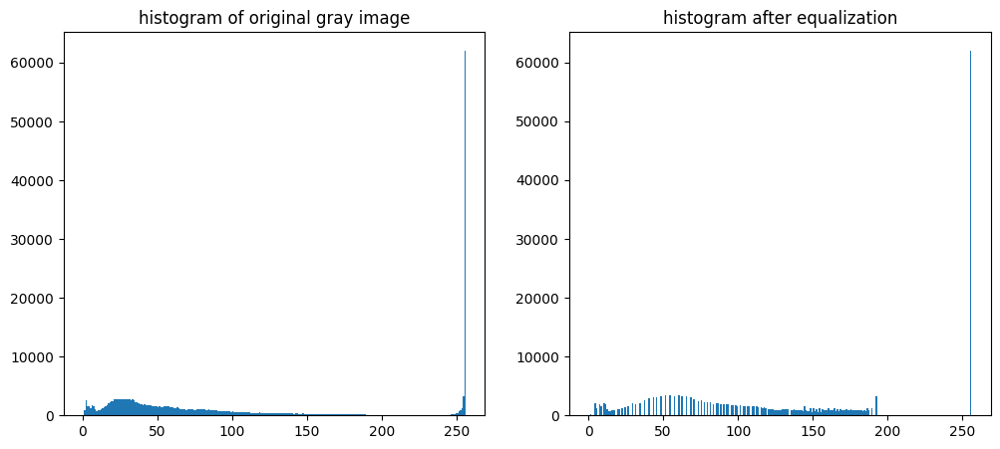

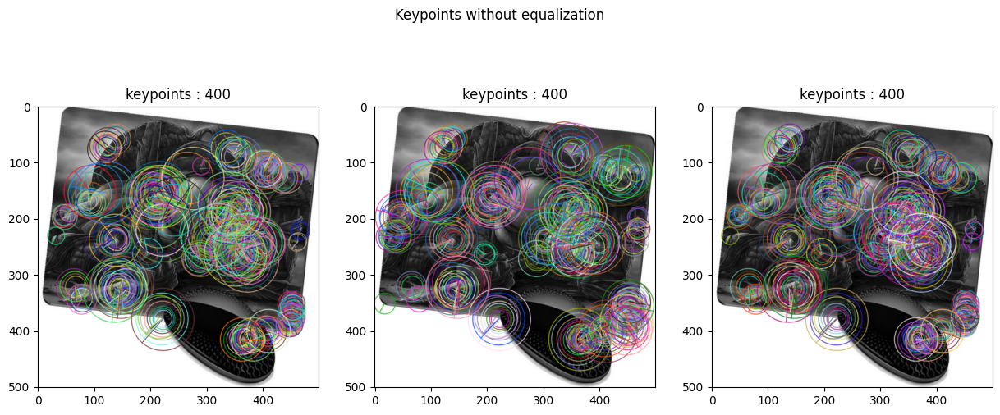

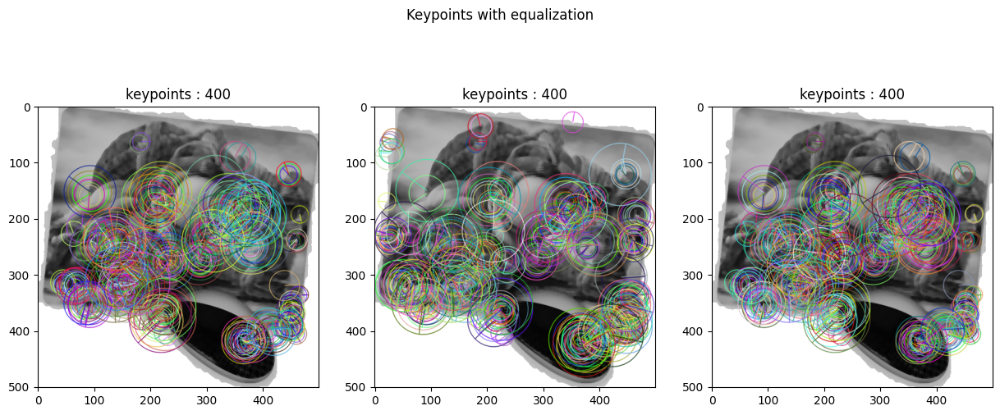

a8ea6fc2b3cd95f46bced80853ce8e0e.jpg


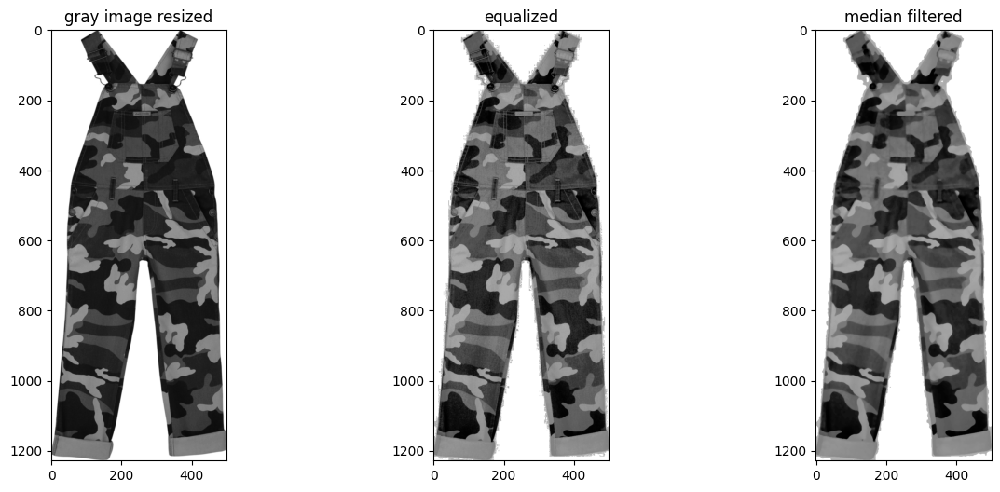

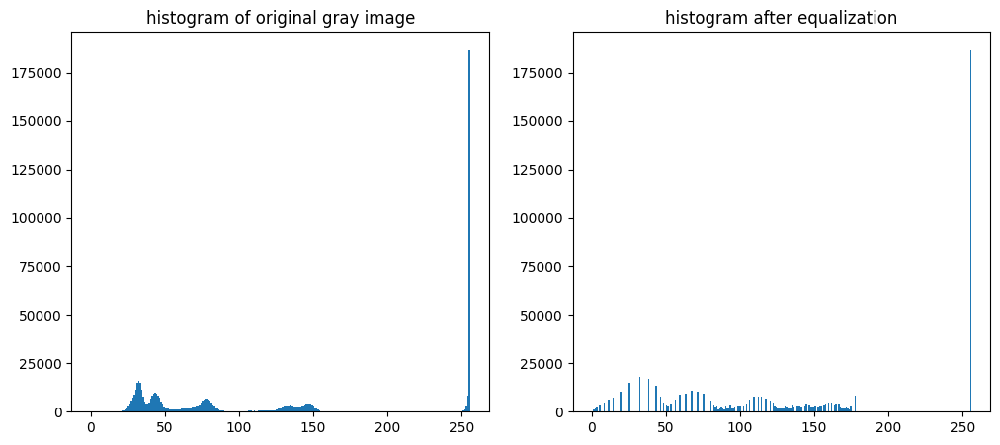

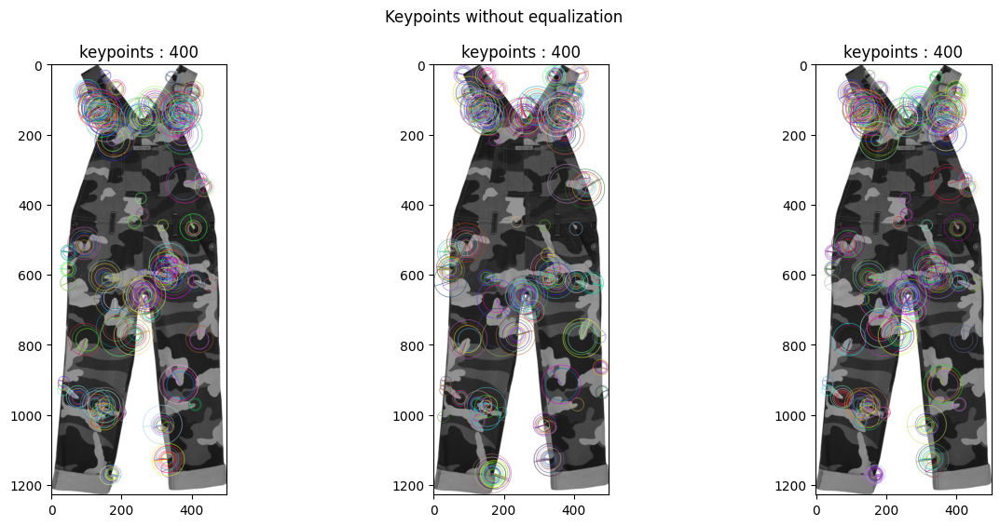

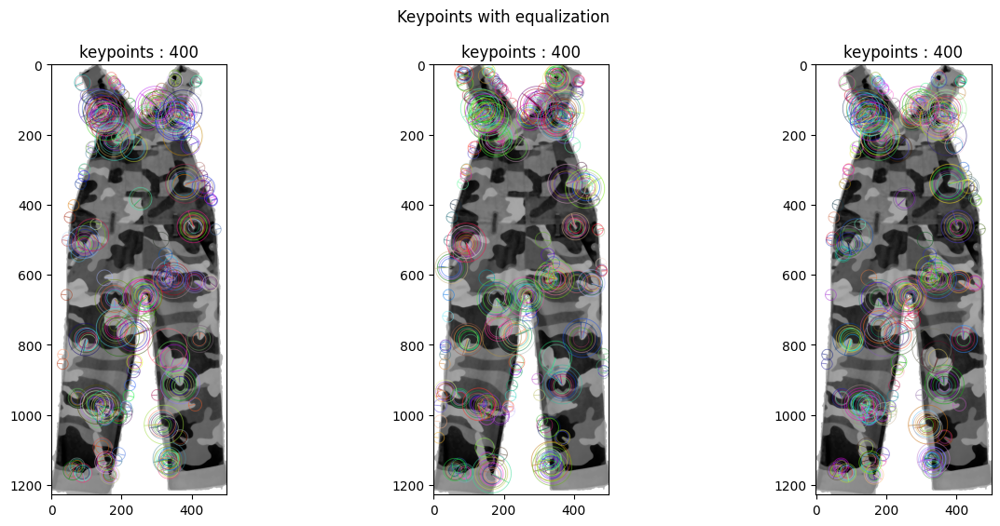

b5d1b8ef70b1ce27726f7f6c2f373e56.jpg


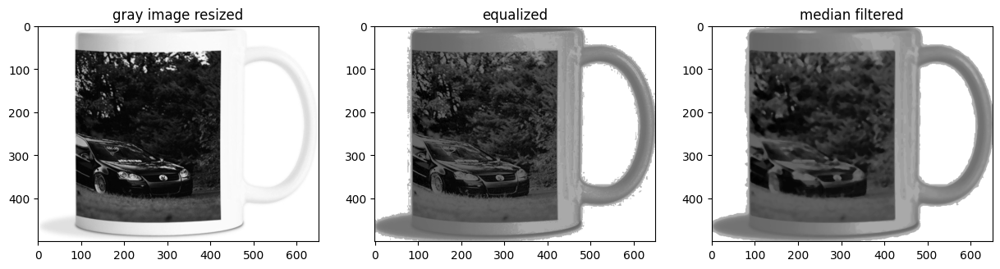

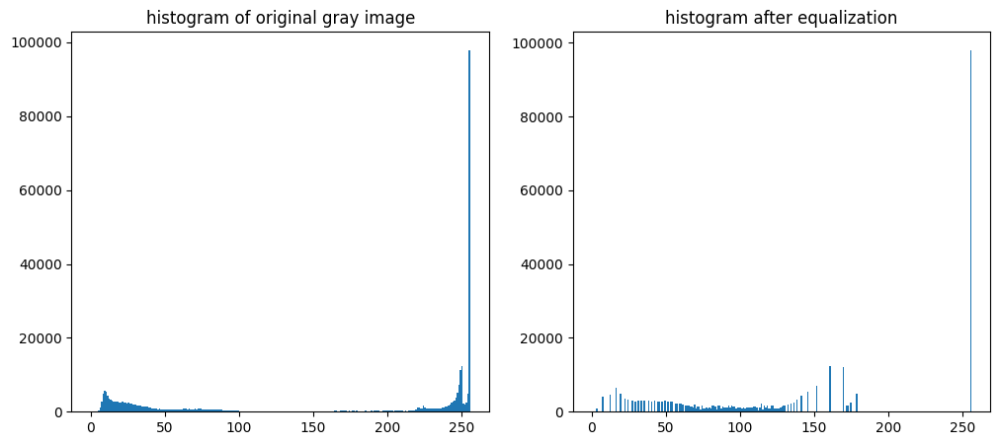

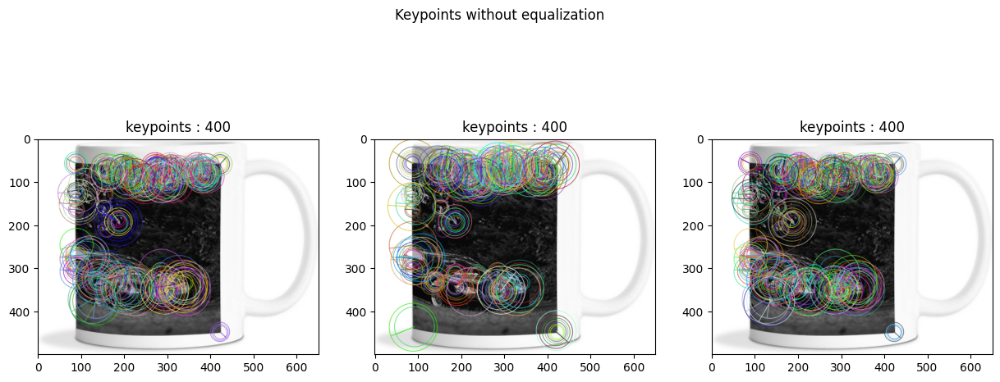

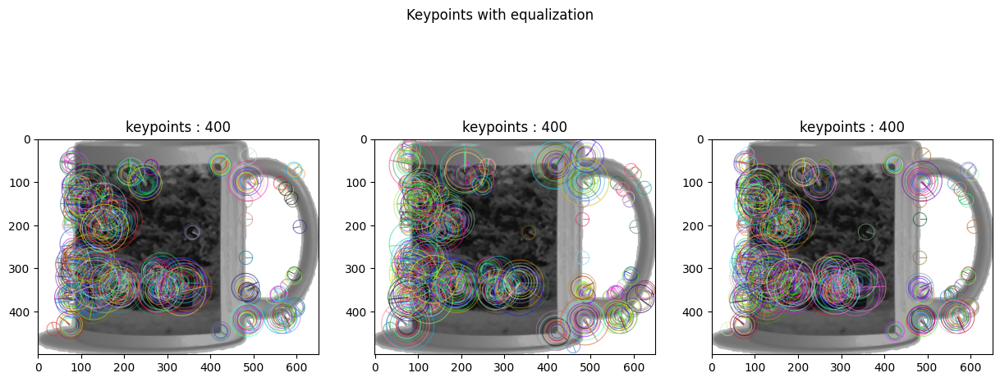

7cbbe686c4a233e8cf53528748f75223.jpg


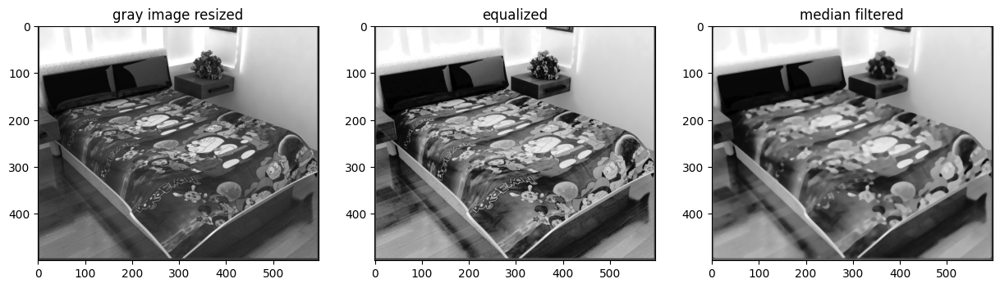

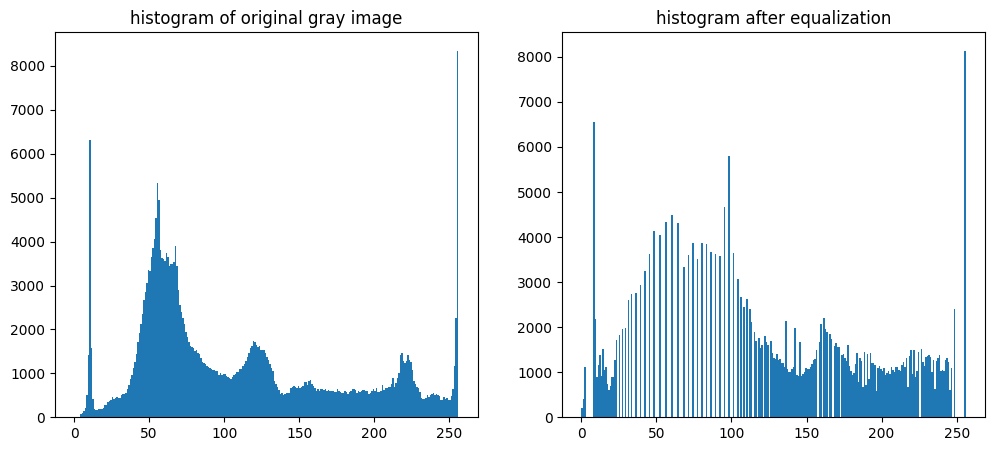

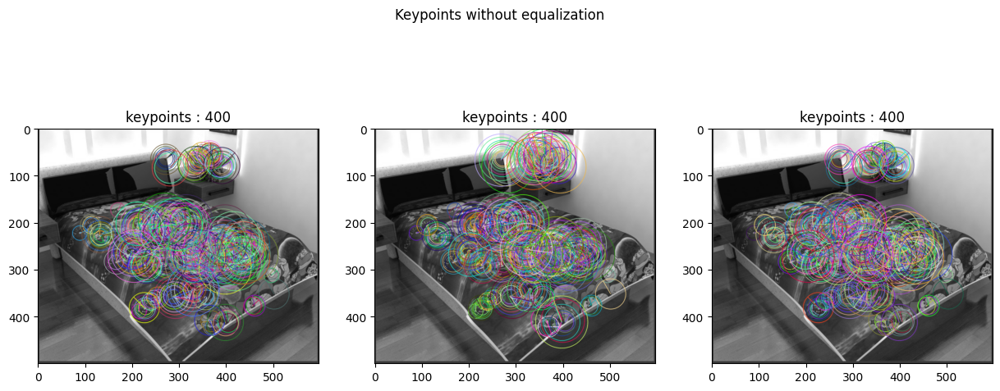

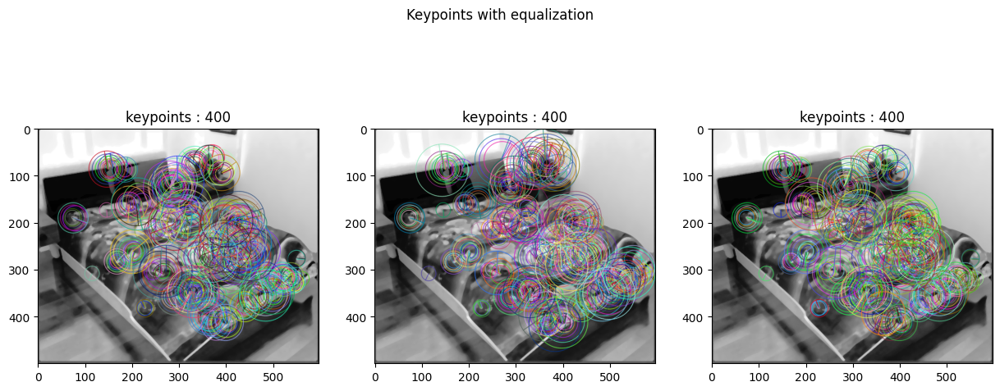

In [108]:
# pick random images 
names = metadata.image.sample(5)
nfeatures = 400
n_pixels = 500

# Less ORB conf
orb1 = cv.ORB_create(nfeatures=nfeatures)
orb2 = cv.ORB_create(nfeatures=nfeatures, edgeThreshold=15)
orb3 = cv.ORB_create(nfeatures=nfeatures, fastThreshold=13)
orbs = [eval('orb' + str(k)) for k in range(1, 4)]

for name in names:
    print(name)
    img_ = cv.imread(image_dir + name)
    img_ = pt.resize_based_on_lowest_dimension(img_, n_pixels=n_pixels)
    gray_img_= cv.cvtColor(img_,cv.COLOR_BGR2GRAY)
    # Increase contrasts.
    gray_img_eq= cv.equalizeHist(gray_img_)
    gray_img_filt = cv.medianBlur(gray_img_eq, 7)
    # gray_img_ = cv.bilateralFilter(gray_img_, 9,100,100)

    fig, ax = plt.subplots(1, 3, figsize=(15,6))
    ax[0].imshow(gray_img_, cmap='gray')
    ax[0].set_title('gray image resized')
    ax[1].imshow(gray_img_eq, cmap='gray')
    ax[1].set_title('equalized')
    ax[2].imshow(gray_img_filt, cmap='gray')
    ax[2].set_title('median filtered')
    plt.show()
    
    fig, ax = plt.subplots(1, 2, figsize=(12,5))
    ax[0].hist(gray_img_.ravel(),256,[0,256])
    ax[0].set_title('histogram of original gray image')
    ax[1].hist(gray_img_filt.ravel(),256,[0,256])
    ax[1].set_title('histogram after equalization')
    # Plot results with the gray image
    fig, axes = plt.subplots(1, 3, figsize=(15, 6))

    for ax, orb in zip(axes.flat, orbs):
        kp, desc = orb.detectAndCompute(gray_img_, None)
        img_kp = cv.drawKeypoints(image=gray_img_,
                                  keypoints=kp,
                                  outImage=0,
                                  flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        ax.imshow(img_kp)
        ax.set_title(f'keypoints : {len(kp)}')
    plt.suptitle('Keypoints without equalization')    
    plt.show()
    
    # PLot results with hist equalization and median blurring.
    fig, axes = plt.subplots(1, 3, figsize=(15, 6))

    for ax, orb in zip(axes.flat, orbs):
        kp, desc = orb.detectAndCompute(gray_img_filt, None)
        img_kp = cv.drawKeypoints(image=gray_img_filt,
                                  keypoints=kp,
                                  outImage=0,
                                  flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        ax.imshow(img_kp)
        ax.set_title(f'keypoints : {len(kp)}')
    plt.suptitle('Keypoints with equalization')    
    plt.show()

It gives different results. Not sure this will be better, but let's try it.

# 5.  [&#9650;](#toc0_) <a id='toc5_'></a>Generate ORB descriptors with histogram equalization and median filtering

In [166]:
image_dir = './data/Flipkart/Images/'
filenames = glob(image_dir + '*.jpg')
# List which will receive all descriptors of all images 
# to fit a clusterer and map each descriptor to a class.
descriptors_list = []

nfeatures = 500
n_pixels = 500
fastThreshold = 13

# Limit to the main 'nfeatures' descriptors per image.
orb = cv.ORB_create(nfeatures=nfeatures, fastThreshold=fastThreshold)

for filename in tqdm(filenames):
    # Read image and convert to gray
    img = cv.imread(filename)
    img = pt.resize_based_on_lowest_dimension(img, n_pixels=n_pixels)
    gray_img= cv.cvtColor(img,cv.COLOR_BGR2GRAY)
    # Increase contrasts.
    gray_img_eq= cv.equalizeHist(gray_img)
    gray_img_filt = cv.medianBlur(gray_img_eq, 7)
    # Find the keypoints with ORB
    _, descriptors = orb.detectAndCompute(gray_img_filt, None)
    descriptors_list.append(descriptors)

100%|██████████| 1050/1050 [01:20<00:00, 13.00it/s]


## 5.1.  [&#9650;](#toc0_) <a id='toc5_1_'></a>Exploration

In [168]:
# Make some metadata on descriptors
n_descriptors = []

for desc in descriptors_list:
    if desc is None:
        n_descriptors.append(0)
    else:
        n_descriptors.append(desc.shape[0])

metadata['n_descriptors'] = n_descriptors
metadata.head()

,image,shape,n_pixels,mean_gray,min_gray,max_gray,category,n_descriptors
0,009099b1f6e1e8f893ec29a7023153c4.jpg,"(1162, 687, 3)",798294,172.415863,0,255,watches,500
1,0096e89cc25a8b96fb9808716406fe94.jpg,"(904, 1478, 3)",1336112,156.565580,0,255,kitchen_&_dining,500
2,00cbbc837d340fa163d11e169fbdb952.jpg,"(326, 1347, 3)",439122,192.004357,9,255,home_furnishing,500
3,00d84a518e0550612fcfcba3b02b6255.jpg,"(857, 1100, 3)",942700,168.342569,0,255,beauty_and_personal_care,500
4,00e966a5049a262cfc72e6bbf68b80e7.jpg,"(1100, 962, 3)",1058200,171.585655,3,255,computers,500


In [169]:
metadata.n_descriptors.describe()

count    1050.000000
mean      497.128571
std        19.556709
min       216.000000
25%       500.000000
50%       500.000000
75%       500.000000
max       595.000000
Name: n_descriptors, dtype: float64

The pre-processing at least gave descriptors to all images.

In [170]:
# Create a matrix of all descriptors
all_descriptors = np.vstack(descriptors_list)
all_descriptors.shape

(521985, 32)

In [171]:
all_descriptors[:3, :]

array([[  2, 141,  18, 153, 150, 163,  40, 231,  62,   1,  90,  18, 108,
        226,  32,  64, 123,  43,  51, 144,  50, 184,   1, 255,  44,  38,
        158, 192, 148,  72, 161, 136],
       [ 89,   4, 255, 229, 164, 102, 109,  55,  52, 227, 222,  18, 221,
         63,  17, 107, 119, 215,  61, 172, 185, 208, 113, 202, 199, 239,
        254, 128, 165, 240, 241, 120],
       [  3, 159,  98, 153, 247, 243, 186, 119, 157,  77,  92, 167,  44,
        190, 182, 228, 238,  59, 151, 149, 151, 185,  52, 255,  62,  92,
        138, 195, 159,  12, 189, 223]], dtype=uint8)

## 5.2.  [&#9650;](#toc0_) <a id='toc5_2_'></a>Create image vectors

### 5.2.1.  [&#9650;](#toc0_) <a id='toc5_2_1_'></a>Finding visual words

In [172]:
n_clusters = 200

from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import KMeans

# kmeans = KMeans(n_clusters=n_clusters, n_init=5)
kmeans = MiniBatchKMeans(
    n_clusters=n_clusters,
    batch_size=1024,
    n_init=5
)

kmeans.fit(all_descriptors)


MiniBatchKMeans(n_clusters=200, n_init=5)

## 5.3.  [&#9650;](#toc0_) <a id='toc5_3_'></a>Build the image vector for the first image

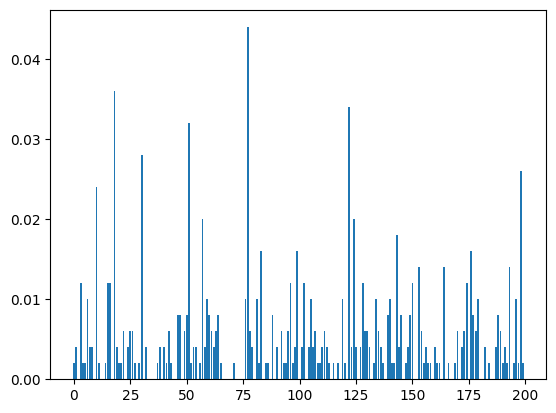

array([0.002, 0.004, 0.   , 0.012, 0.002, 0.002, 0.01 , 0.004, 0.004,
       0.   , 0.024, 0.002, 0.   , 0.   , 0.002, 0.012, 0.012, 0.   ,
       0.036, 0.004, 0.002, 0.002, 0.006, 0.   , 0.004, 0.006, 0.006,
       0.002, 0.   , 0.002, 0.028, 0.   , 0.004, 0.   , 0.   , 0.   ,
       0.   , 0.002, 0.004, 0.   , 0.004, 0.002, 0.006, 0.002, 0.   ,
       0.   , 0.008, 0.008, 0.   , 0.006, 0.008, 0.032, 0.002, 0.004,
       0.004, 0.   , 0.002, 0.02 , 0.004, 0.01 , 0.008, 0.006, 0.004,
       0.006, 0.008, 0.002, 0.   , 0.   , 0.   , 0.   , 0.   , 0.002,
       0.   , 0.   , 0.   , 0.   , 0.01 , 0.044, 0.006, 0.004, 0.   ,
       0.01 , 0.002, 0.016, 0.   , 0.002, 0.002, 0.   , 0.008, 0.   ,
       0.004, 0.   , 0.006, 0.002, 0.002, 0.006, 0.012, 0.002, 0.004,
       0.016, 0.   , 0.004, 0.012, 0.   , 0.004, 0.01 , 0.004, 0.006,
       0.002, 0.002, 0.004, 0.006, 0.004, 0.002, 0.   , 0.002, 0.   ,
       0.002, 0.   , 0.01 , 0.002, 0.   , 0.034, 0.004, 0.02 , 0.004,
       0.   , 0.004,

In [173]:
img_descriptors = descriptors_list[0]

img_vect = pt.create_image_vector_from_descriptors(
    img_descriptors,
    kmeans,
)
        
plt.bar(range(n_clusters), img_vect)
plt.show()
img_vect

## 5.4.  [&#9650;](#toc0_) <a id='toc5_4_'></a>Image vectors on the full dataset.

In [174]:
from collections import defaultdict

histo = defaultdict()
myzip = zip(descriptors_list, metadata.image,)

for img_descriptors, image_name in tqdm(myzip):
    histo[image_name] = pt.create_image_vector_from_descriptors(
        img_descriptors=img_descriptors,
        fit_kmeans=kmeans,
    )
    
    

1050it [00:01, 875.61it/s]


In [175]:
image_vectors = pd.DataFrame(
    histo,
    index=[f'feature_class_{k}' for k in range(n_clusters)]
).T

image_vectors.head()

,feature_class_0,feature_class_1,feature_class_2,feature_class_3,feature_class_4,feature_class_5,feature_class_6,feature_class_7,feature_class_8,feature_class_9,...,feature_class_190,feature_class_191,feature_class_192,feature_class_193,feature_class_194,feature_class_195,feature_class_196,feature_class_197,feature_class_198,feature_class_199
009099b1f6e1e8f893ec29a7023153c4.jpg,0.002,0.004,0.000,0.012,0.002,0.002,0.010,0.004,0.004,0.000,...,0.002,0.004,0.002,0.014,0.000,0.002,0.010,0.002,0.026,0.002
0096e89cc25a8b96fb9808716406fe94.jpg,0.000,0.008,0.004,0.004,0.000,0.000,0.014,0.002,0.012,0.002,...,0.004,0.002,0.000,0.002,0.020,0.006,0.000,0.000,0.004,0.006
00cbbc837d340fa163d11e169fbdb952.jpg,0.000,0.002,0.002,0.006,0.002,0.004,0.002,0.000,0.000,0.002,...,0.002,0.016,0.020,0.014,0.000,0.000,0.014,0.000,0.012,0.008
00d84a518e0550612fcfcba3b02b6255.jpg,0.008,0.000,0.004,0.006,0.000,0.012,0.002,0.000,0.002,0.004,...,0.006,0.000,0.014,0.014,0.004,0.004,0.008,0.012,0.018,0.004
00e966a5049a262cfc72e6bbf68b80e7.jpg,0.000,0.000,0.000,0.022,0.004,0.000,0.000,0.000,0.000,0.000,...,0.002,0.002,0.030,0.018,0.000,0.000,0.014,0.004,0.010,0.004


In [176]:
X = image_vectors.values

In [177]:
X.shape

(1050, 200)

179
2
5
8
10
15
30


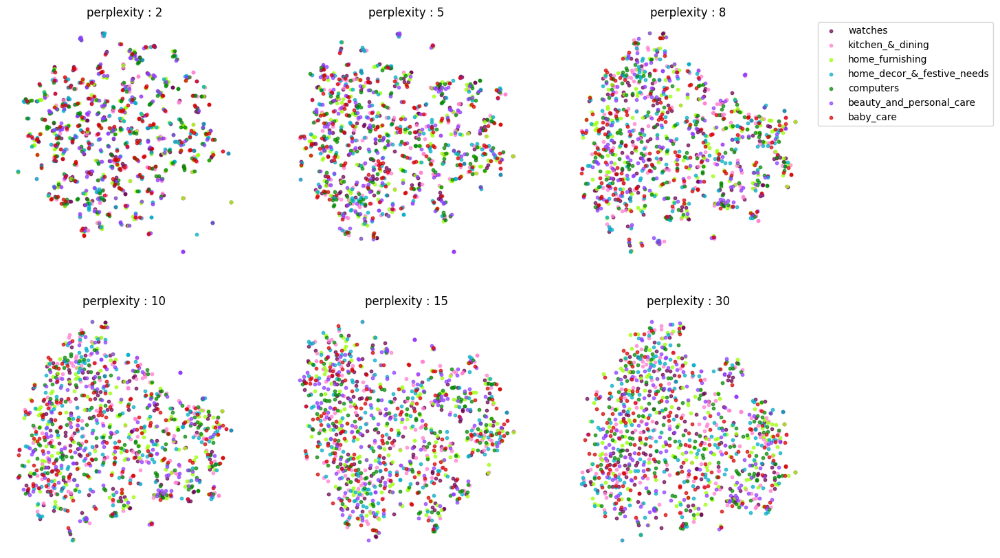

In [178]:
# Reduce information and compute t-SNE
pca = PCA(n_components=0.99)
X_pca = pca.fit_transform(X)
print(pca.n_components_)

ds.find_tsne_best_perplexity(
    X_pca,
    perplexities=[2, 5, 8, 10, 15, 30],
    labels=metadata.category,
)

In [179]:
kmeans = KMeans(n_clusters=7, n_init=5)
pca = PCA(n_components=0.8)
svd = TruncatedSVD(n_components=20)
tsne = TSNE(n_components=2, perplexity=8)

pipelines = {
    'kmeans': make_pipeline(kmeans),
    'svd_kmeans': make_pipeline(svd, kmeans),
    'pca_kmeans': make_pipeline(pca, kmeans),
    'tsne_kmeans': make_pipeline(tsne, kmeans),
}


true_labels = metadata.category

# Results containers
evaluations = []
evaluations_std = []

for pipe_name, pipe in pipelines.items():
    
    model_name = (
        pipe_name 
        + '\non ORB v2 histograms'
        + '\nvoc :200'
    )
    
    print('***********')
    print(model_name)
    ds.fit_and_evaluate_clusters(
        model=pipe,
        X=X,
        labels=true_labels,
        name=model_name,
        evaluations=evaluations,
        evaluations_std=evaluations_std,
    ) 

***********
kmeans
on ORB v2 histograms
voc :200
clustering done in 0.40 ± 0.07 s 
Homogeneity: 0.008 ± 0.000
Completeness: 0.010 ± 0.000
V-measure: 0.009 ± 0.000
Adjusted Rand-Index: -0.000 ± 0.000
Silhouette: 0.078 ± 0.002
***********
svd_kmeans
on ORB v2 histograms
voc :200
clustering done in 0.71 ± 0.10 s 
Homogeneity: 0.008 ± 0.001
Completeness: 0.010 ± 0.001
V-measure: 0.009 ± 0.001
Adjusted Rand-Index: -0.001 ± 0.001
Silhouette: 0.074 ± 0.010
***********
pca_kmeans
on ORB v2 histograms
voc :200
clustering done in 0.50 ± 0.08 s 
Homogeneity: 0.008 ± 0.001
Completeness: 0.011 ± 0.001
V-measure: 0.009 ± 0.001
Adjusted Rand-Index: -0.001 ± 0.000
Silhouette: 0.081 ± 0.001
***********
tsne_kmeans
on ORB v2 histograms
voc :200
clustering done in 6.16 ± 1.88 s 
Homogeneity: 0.008 ± 0.001
Completeness: 0.008 ± 0.001
V-measure: 0.008 ± 0.001
Adjusted Rand-Index: -0.001 ± 0.001
Silhouette: 0.014 ± 0.008


So it has become a total random association. Probably because what we detect with the histogram equalization as keypoints are all the noisy pixels we get when doing image contour detection. 

# Generating something similar to the first version with less features and observing the cosine similarities matches.

In [184]:
image_dir = './data/Flipkart/Images/'
filenames = glob(image_dir + '*.jpg')
# List which will receive all descriptors of all images 
# to fit a clusterer and map each descriptor to a class.
descriptors_list = []

nfeatures = 200
n_pixels = 500
fastThreshold = 13

# Limit to the main 'nfeatures' descriptors per image.
orb = cv.ORB_create(nfeatures=nfeatures, fastThreshold=fastThreshold)

for filename in tqdm(filenames):
    # Read image and convert to gray
    img = cv.imread(filename)
    img = pt.resize_based_on_lowest_dimension(img, n_pixels=n_pixels)
    gray_img= cv.cvtColor(img,cv.COLOR_BGR2GRAY)
    # Find the keypoints with ORB
    _, descriptors = orb.detectAndCompute(gray_img, None)
    descriptors_list.append(descriptors)

100%|██████████| 1050/1050 [00:57<00:00, 18.15it/s]


## 5.1.  [&#9650;](#toc0_) <a id='toc5_1_'></a>Exploration

In [187]:
# Make some metadata on descriptors
n_descriptors = []

for desc in descriptors_list:
    if desc is None:
        n_descriptors.append(0)
    else:
        n_descriptors.append(desc.shape[0])

metadata['n_descriptors'] = n_descriptors
metadata.head()

,image,shape,n_pixels,mean_gray,min_gray,max_gray,category,n_descriptors
0,009099b1f6e1e8f893ec29a7023153c4.jpg,"(1162, 687, 3)",798294,172.415863,0,255,watches,200
1,0096e89cc25a8b96fb9808716406fe94.jpg,"(904, 1478, 3)",1336112,156.565580,0,255,kitchen_&_dining,200
2,00cbbc837d340fa163d11e169fbdb952.jpg,"(326, 1347, 3)",439122,192.004357,9,255,home_furnishing,200
3,00d84a518e0550612fcfcba3b02b6255.jpg,"(857, 1100, 3)",942700,168.342569,0,255,beauty_and_personal_care,200
4,00e966a5049a262cfc72e6bbf68b80e7.jpg,"(1100, 962, 3)",1058200,171.585655,3,255,computers,200


In [188]:
metadata.n_descriptors.describe()

count    1050.000000
mean      197.588571
std        16.430524
min         0.000000
25%       200.000000
50%       200.000000
75%       200.000000
max       200.000000
Name: n_descriptors, dtype: float64

In [190]:
no_descriptor = metadata.query('n_descriptors == 0')
no_descriptor

,image,shape,n_pixels,mean_gray,min_gray,max_gray,category,n_descriptors
893,d7fded8e211b3033e424fb450b97caec.jpg,"(1031, 1452, 3)",1497012,204.557802,0,255,computers,0


In [191]:
# Add descriptors filled with zeros for images with no descriptors
idx_pb = no_descriptor.index
for idx in idx_pb:
    descriptors_list[idx] = np.zeros((1,32))
# Create a matrix of all descriptors
all_descriptors = np.vstack(descriptors_list)
all_descriptors.shape

(206249, 32)

In [192]:
all_descriptors[:3, :]

array([[ 24., 232., 186., 162.,  98.,  97.,  83., 206., 162.,  21.,  12.,
         41.,  55., 155., 107.,  24., 163., 219., 117.,  83.,  10.,   3.,
         10.,  32., 209., 197.,  60.,  45., 164.,  83.,  54.,  75.],
       [ 15.,  59., 240.,  27., 187.,  57., 187., 152., 111., 213.,  60.,
        229., 232., 232., 223., 141.,  30.,  99., 239.,  85., 134., 104.,
        207., 224.,  14.,  24.,  68., 219., 207., 215.,  75., 221.],
       [157.,  17., 159., 175.,  38.,  14.,  97.,  25.,  38.,  88.,  83.,
         96., 255.,  81.,  25.,  43.,  50.,  13.,  53.,  79., 209., 244.,
         27.,   1., 196., 225., 106., 128., 108., 163.,  35., 161.]])

## 5.2.  [&#9650;](#toc0_) <a id='toc5_2_'></a>Create image vectors

### 5.2.1.  [&#9650;](#toc0_) <a id='toc5_2_1_'></a>Finding visual words

In [208]:
n_clusters = 100

from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=n_clusters, n_init=5)
# kmeans = MiniBatchKMeans(
#     n_clusters=n_clusters,
#     batch_size=1024,
#     n_init=5
# )

kmeans.fit(all_descriptors)


KMeans(n_clusters=100, n_init=5)

## 5.3.  [&#9650;](#toc0_) <a id='toc5_3_'></a>Build the image vector for the first image

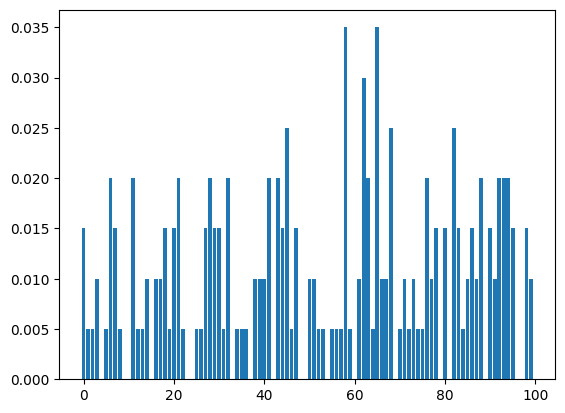

array([0.015, 0.005, 0.005, 0.01 , 0.   , 0.005, 0.02 , 0.015, 0.005,
       0.   , 0.   , 0.02 , 0.005, 0.005, 0.01 , 0.   , 0.01 , 0.01 ,
       0.015, 0.005, 0.015, 0.02 , 0.005, 0.   , 0.   , 0.005, 0.005,
       0.015, 0.02 , 0.015, 0.015, 0.005, 0.02 , 0.   , 0.005, 0.005,
       0.005, 0.   , 0.01 , 0.01 , 0.01 , 0.02 , 0.   , 0.02 , 0.015,
       0.025, 0.005, 0.015, 0.   , 0.   , 0.01 , 0.01 , 0.005, 0.005,
       0.   , 0.005, 0.005, 0.005, 0.035, 0.005, 0.   , 0.01 , 0.03 ,
       0.02 , 0.005, 0.035, 0.01 , 0.01 , 0.025, 0.   , 0.005, 0.01 ,
       0.005, 0.01 , 0.005, 0.005, 0.02 , 0.01 , 0.015, 0.   , 0.015,
       0.   , 0.025, 0.015, 0.005, 0.01 , 0.015, 0.01 , 0.02 , 0.   ,
       0.015, 0.01 , 0.02 , 0.02 , 0.02 , 0.015, 0.   , 0.   , 0.015,
       0.01 ])

In [210]:
img_descriptors = descriptors_list[0]

img_vect = pt.create_image_vector_from_descriptors(
    img_descriptors,
    kmeans,
)
        
plt.bar(range(n_clusters), img_vect)
plt.show()
img_vect

## 5.4.  [&#9650;](#toc0_) <a id='toc5_4_'></a>Image vectors on the full dataset.

In [211]:
from collections import defaultdict

histo = defaultdict()
myzip = zip(descriptors_list, metadata.image,)

for img_descriptors, image_name in tqdm(myzip):
    histo[image_name] = pt.create_image_vector_from_descriptors(
        img_descriptors=img_descriptors,
        fit_kmeans=kmeans,
    )
    
    

1050it [00:00, 1274.99it/s]


In [212]:
image_vectors = pd.DataFrame(
    histo,
    index=[f'feature_class_{k}' for k in range(n_clusters)]
).T

image_vectors.head()

,feature_class_0,feature_class_1,feature_class_2,feature_class_3,feature_class_4,feature_class_5,feature_class_6,feature_class_7,feature_class_8,feature_class_9,...,feature_class_90,feature_class_91,feature_class_92,feature_class_93,feature_class_94,feature_class_95,feature_class_96,feature_class_97,feature_class_98,feature_class_99
009099b1f6e1e8f893ec29a7023153c4.jpg,0.015,0.005,0.005,0.010,0.00,0.005,0.02,0.015,0.005,0.000,...,0.015,0.010,0.020,0.020,0.020,0.015,0.000,0.000,0.015,0.01
0096e89cc25a8b96fb9808716406fe94.jpg,0.015,0.000,0.000,0.000,0.02,0.010,0.00,0.000,0.025,0.010,...,0.000,0.025,0.000,0.000,0.000,0.015,0.015,0.015,0.020,0.00
00cbbc837d340fa163d11e169fbdb952.jpg,0.000,0.010,0.000,0.005,0.00,0.020,0.00,0.030,0.000,0.015,...,0.005,0.000,0.000,0.015,0.020,0.010,0.025,0.010,0.000,0.00
00d84a518e0550612fcfcba3b02b6255.jpg,0.000,0.000,0.010,0.050,0.00,0.020,0.00,0.010,0.010,0.015,...,0.005,0.000,0.005,0.015,0.005,0.005,0.025,0.020,0.000,0.00
00e966a5049a262cfc72e6bbf68b80e7.jpg,0.000,0.030,0.015,0.035,0.00,0.000,0.01,0.000,0.010,0.005,...,0.000,0.000,0.005,0.040,0.005,0.075,0.015,0.005,0.000,0.00


3: 1.0
359: 0.8113
773: 0.7972
987: 0.7874
418: 0.7788
823: 0.7706
505: 0.7681
213: 0.7666
674: 0.7623
890: 0.7538


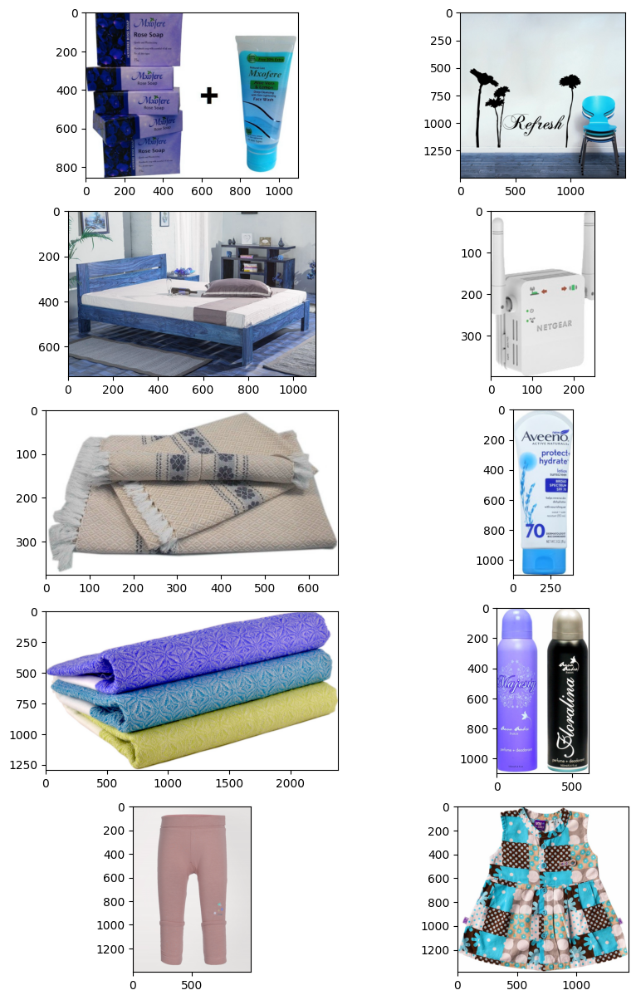

In [213]:
from numpy.linalg import norm

top_k = 10
i = 3

# Pick a reference image
a = image_vectors.values[i]
# Pick the images I want to search similarity with. 
b = image_vectors.values  

# get the cosine distance for the search image `a`
cosine_similarity = np.dot(a, b.T)/(norm(a) * norm(b, axis=1))
# get the top k indices for most similar vecs
idx = np.argsort(-cosine_similarity)[:top_k]

# display the results
image_dir_path = './data/Flipkart/Images/'

fig, axes = plt.subplots(5,2, figsize=(10,15))
for i, ax in zip(idx, axes.flat):
    img = cv.imread(image_dir_path + metadata.image[i])
    print(f"{i}: {round(cosine_similarity[i], 4)}")
    ax.imshow(img, cmap='gray')

plt.show()

7: 1.0
314: 0.7232
747: 0.7119
697: 0.7117
939: 0.7082
748: 0.6973
603: 0.6936
785: 0.6893
382: 0.6814
255: 0.6804


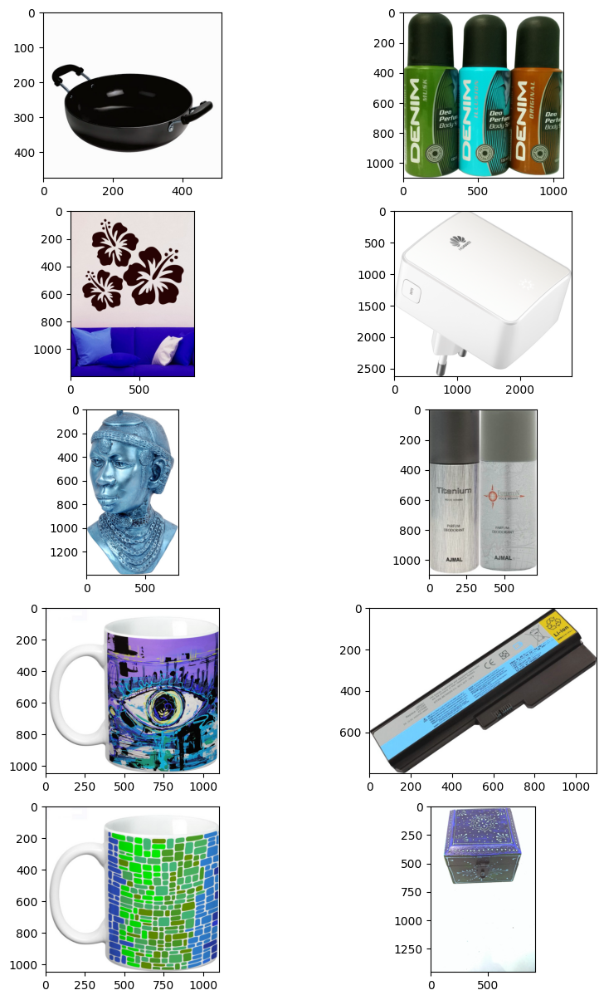

In [214]:
top_k = 10
i = 7

# Pick a reference image
a = image_vectors.values[i]
# Pick the images I want to search similarity with. 
b = image_vectors.values  

# get the cosine distance for the search image `a`
cosine_similarity = np.dot(a, b.T)/(norm(a) * norm(b, axis=1))
# get the top k indices for most similar vecs
idx = np.argsort(-cosine_similarity)[:top_k]

# display the results
image_dir_path = './data/Flipkart/Images/'

fig, axes = plt.subplots(5,2, figsize=(10,15))
for i, ax in zip(idx, axes.flat):
    img = cv.imread(image_dir_path + metadata.image[i])
    print(f"{i}: {round(cosine_similarity[i], 4)}")
    ax.imshow(img, cmap='gray')

plt.show()

178: 1.0
549: 0.7739
848: 0.7316
552: 0.7187
82: 0.7051
580: 0.7034
723: 0.7021
626: 0.6951
903: 0.6937
937: 0.6888


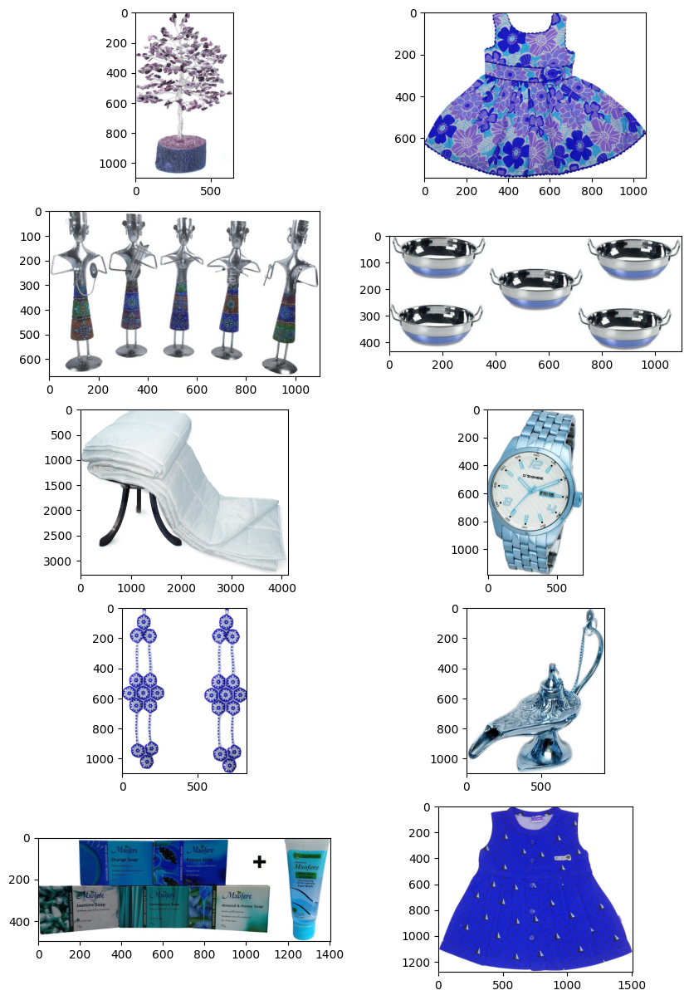

In [215]:
top_k = 10
i = 178

# Pick a reference image
a = image_vectors.values[i]
# Pick the images I want to search similarity with. 
b = image_vectors.values  

# get the cosine distance for the search image `a`
cosine_similarity = np.dot(a, b.T)/(norm(a) * norm(b, axis=1))
# get the top k indices for most similar vecs
idx = np.argsort(-cosine_similarity)[:top_k]

# display the results
image_dir_path = './data/Flipkart/Images/'

fig, axes = plt.subplots(5,2, figsize=(10,15))
for i, ax in zip(idx, axes.flat):
    img = cv.imread(image_dir_path + metadata.image[i])
    print(f"{i}: {round(cosine_similarity[i], 4)}")
    ax.imshow(img, cmap='gray')

plt.show()

This looks much more random than what we obtained with SIFT.